In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import os
import seaborn as sn
import copy

from sklearn.cluster import SpectralBiclustering
from sklearn.cluster import SpectralCoclustering
from sklearn.metrics import consensus_score

In [2]:
data_dir = '/home/breuter/MalariaVaccineEfficacyPrediction/data/proteome_data'
data_whole_raw = pd.read_csv(os.path.join(data_dir, 'whole_proteomearray_rawdata.csv'))

In [3]:
data_whole_raw.describe()

,group,Protection,Dose,TimePointOrder,mal_mito_3.iso1.exon1.amp1_4066,mal_mito_2.iso1.exon1.amp1_1466,mal_mito_1.iso1.exon1.amp1_3777,PFL2430c_484,PFL2215w_4059,PFL1550w_501,...,MAL8P1.320_1o1_4243,MAL8P1.156_187,MAL8P1.155_2o3_4890,MAL8P1.143_3o15_2092,MAL8P1.143_1o15_2416,MAL8P1.143_14o15_1450,MAL8P1.140_4049,MAL7P1.32_5037,MAL13P1.303e4s1_1829,MAL13P1.303e1s1_4421
count,160.000000,160.000000,160.000000,160.000000,160.000000,160.000000,160.000000,160.000000,160.000000,160.000000,...,160.000000,160.000000,160.000000,160.00000,160.000000,160.000000,160.000000,160.000000,160.000000,160.000000
mean,37.600000,0.450000,1.350000,2.500000,1575.368750,1980.187500,1596.553125,5343.231250,2751.878125,1218.350000,...,2130.809375,2374.412500,2016.793750,4893.51875,2292.065625,2833.868750,2194.959375,10395.775000,2311.290625,1931.459375
std,20.790419,0.499056,1.155789,1.121544,723.597004,1349.725737,701.341250,6988.437302,2658.485907,590.257336,...,1148.832485,1251.264944,1233.997046,4922.60840,1498.870017,2091.462977,1169.775974,15322.508142,1605.516268,1079.280228
min,2.000000,0.000000,0.000000,1.000000,-14.000000,38.500000,21.000000,472.500000,490.000000,226.000000,...,480.000000,504.500000,488.000000,505.50000,467.500000,483.000000,512.000000,474.500000,501.000000,390.000000
25%,21.000000,0.000000,0.000000,1.750000,1081.000000,1293.375000,1078.125000,1840.375000,1769.500000,859.875000,...,1356.375000,1547.375000,1253.625000,1786.50000,1344.250000,1563.000000,1385.750000,1848.750000,1371.500000,1205.875000
50%,38.500000,0.000000,1.000000,2.500000,1514.250000,1764.500000,1544.000000,2887.500000,2345.750000,1057.250000,...,1864.500000,2217.500000,1742.000000,3214.00000,1935.000000,2242.000000,2021.250000,3897.500000,1938.250000,1673.000000
75%,52.250000,1.000000,2.000000,3.250000,1897.250000,2276.375000,1866.750000,5619.000000,3110.875000,1432.750000,...,2504.125000,2845.250000,2323.625000,6117.50000,2679.250000,3152.875000,2560.000000,10238.500000,2653.500000,2278.375000
max,73.000000,1.000000,3.000000,4.000000,4849.500000,12755.000000,4096.000000,47448.000000,32755.000000,3894.000000,...,7896.000000,9296.000000,10326.500000,24532.00000,10617.000000,13327.000000,8173.000000,63826.000000,14314.000000,7454.500000


In [7]:
data_whole_raw.describe(include='all')

,Patient,group,Protection,Dose,TimePointOrder,mal_mito_3.iso1.exon1.amp1_4066,mal_mito_2.iso1.exon1.amp1_1466,mal_mito_1.iso1.exon1.amp1_3777,PFL2430c_484,PFL2215w_4059,...,MAL8P1.320_1o1_4243,MAL8P1.156_187,MAL8P1.155_2o3_4890,MAL8P1.143_3o15_2092,MAL8P1.143_1o15_2416,MAL8P1.143_14o15_1450,MAL8P1.140_4049,MAL7P1.32_5037,MAL13P1.303e4s1_1829,MAL13P1.303e1s1_4421
count,160,160.000000,160.000000,160.000000,160.000000,160.000000,160.000000,160.000000,160.000000,160.000000,...,160.000000,160.000000,160.000000,160.00000,160.000000,160.000000,160.000000,160.000000,160.000000,160.000000
unique,160,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,T2-002 C -1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,37.600000,0.450000,1.350000,2.500000,1575.368750,1980.187500,1596.553125,5343.231250,2751.878125,...,2130.809375,2374.412500,2016.793750,4893.51875,2292.065625,2833.868750,2194.959375,10395.775000,2311.290625,1931.459375
std,NaN,20.790419,0.499056,1.155789,1.121544,723.597004,1349.725737,701.341250,6988.437302,2658.485907,...,1148.832485,1251.264944,1233.997046,4922.60840,1498.870017,2091.462977,1169.775974,15322.508142,1605.516268,1079.280228
min,NaN,2.000000,0.000000,0.000000,1.000000,-14.000000,38.500000,21.000000,472.500000,490.000000,...,480.000000,504.500000,488.000000,505.50000,467.500000,483.000000,512.000000,474.500000,501.000000,390.000000
25%,NaN,21.000000,0.000000,0.000000,1.750000,1081.000000,1293.375000,1078.125000,1840.375000,1769.500000,...,1356.375000,1547.375000,1253.625000,1786.50000,1344.250000,1563.000000,1385.750000,1848.750000,1371.500000,1205.875000
50%,NaN,38.500000,0.000000,1.000000,2.500000,1514.250000,1764.500000,1544.000000,2887.500000,2345.750000,...,1864.500000,2217.500000,1742.000000,3214.00000,1935.000000,2242.000000,2021.250000,3897.500000,1938.250000,1673.000000
75%,NaN,52.250000,1.000000,2.000000,3.250000,1897.250000,2276.375000,1866.750000,5619.000000,3110.875000,...,2504.125000,2845.250000,2323.625000,6117.50000,2679.250000,3152.875000,2560.000000,10238.500000,2653.500000,2278.375000


In [4]:
print(np.any(np.isinf(data_whole_raw.iloc[:, 5:].to_numpy())))
print(np.any(np.isnan(data_whole_raw.iloc[:, 5:].to_numpy())))

False
False


In [ ]:
data_whole_raw_AB = data_whole_raw.drop(columns=['Patient', 'group', 'Protection', 'TimePointOrder', 'Dose'])

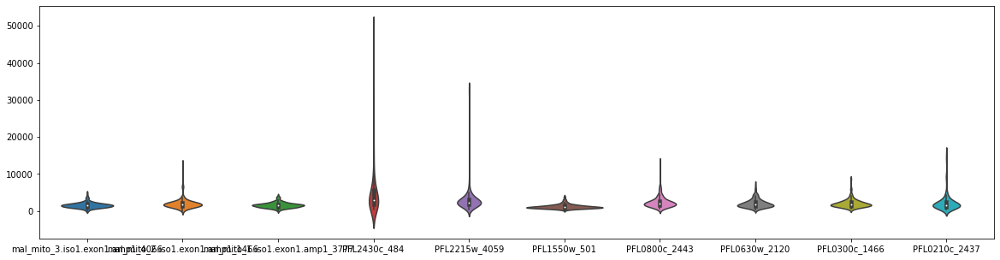

In [12]:
plt.figure(figsize=(20, 5))
sn.violinplot(data=data_whole_raw_AB.iloc[:, :10])
plt.show()
plt.close()

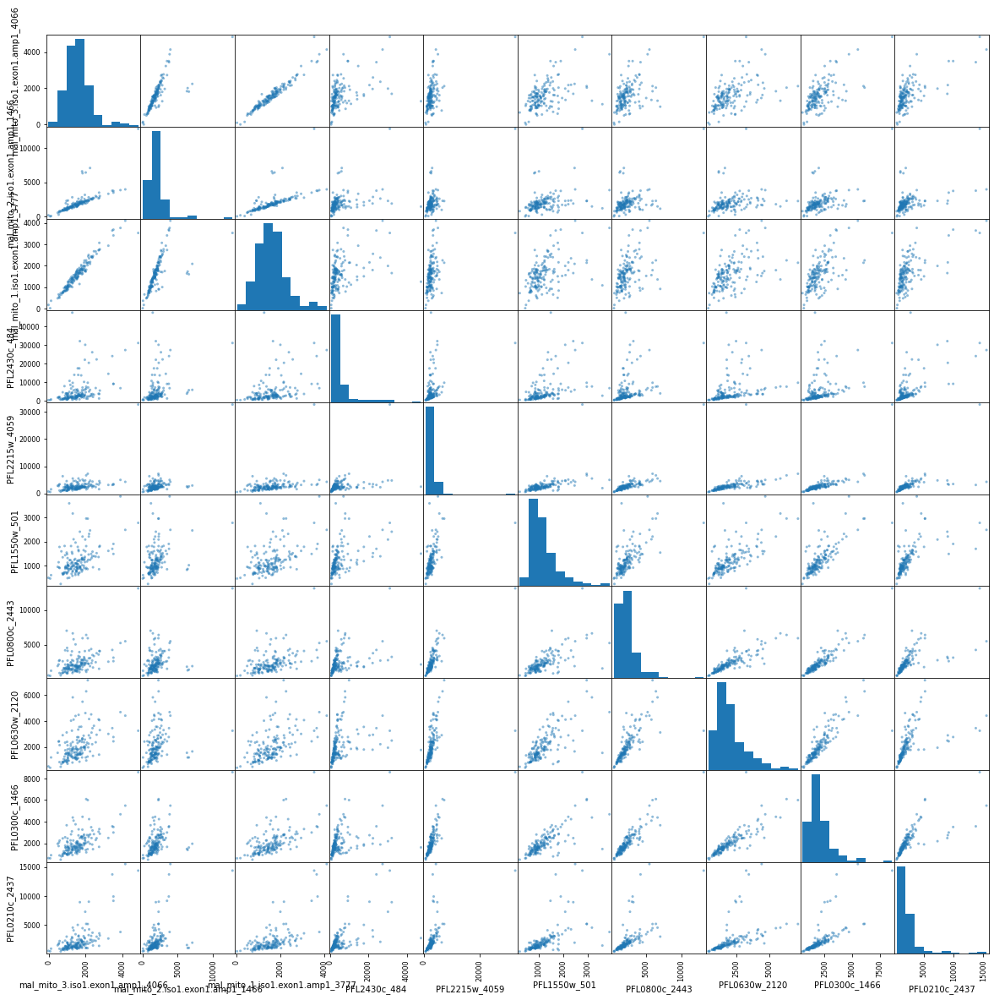

In [14]:
pd.plotting.scatter_matrix(data_whole_raw_AB.iloc[:, :10], figsize=(20, 20))
plt.show()
plt.close()

In [18]:
np.ceil(np.abs(data_whole_raw_AB.min().min()))

2429.0

In [19]:
data_whole_raw_AB.max().max()

65290.0

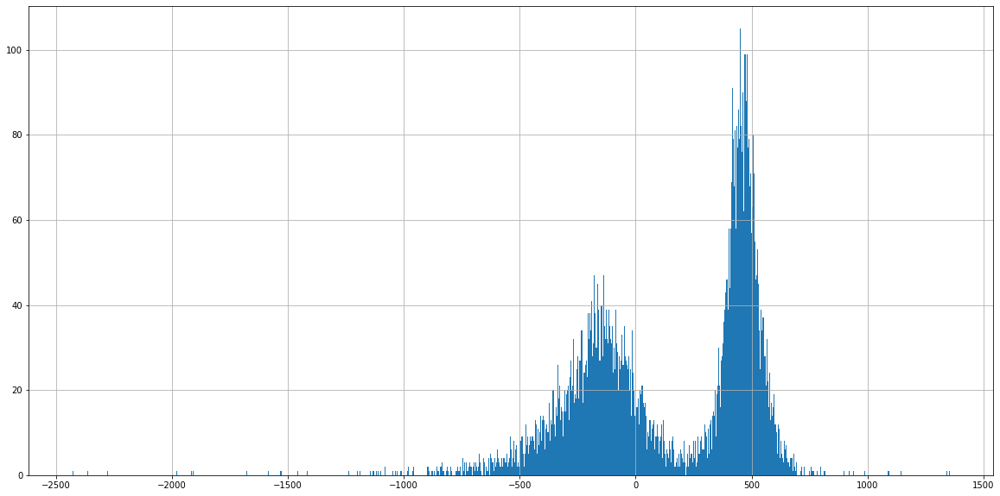

In [20]:
plt.figure(figsize=(20, 10))
data_whole_raw_AB.min().hist(bins=1000)
plt.show()
plt.close()

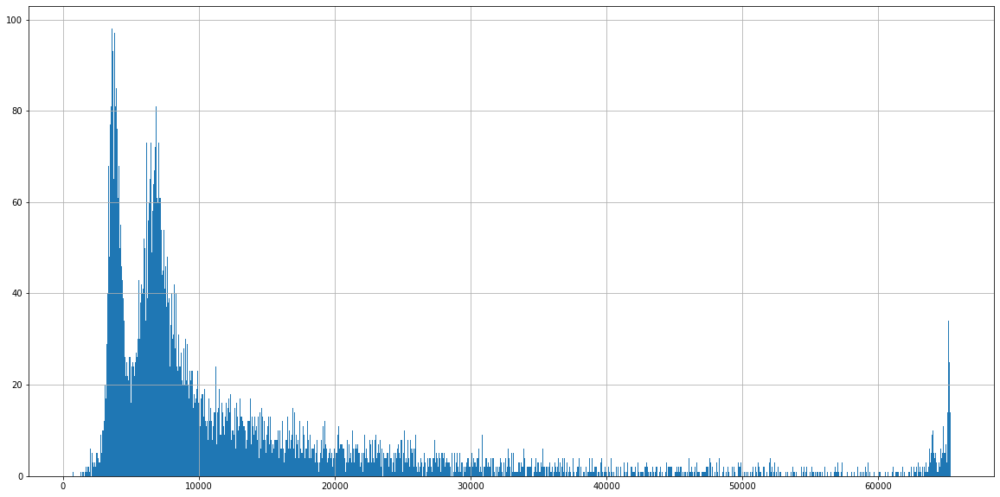

In [21]:
plt.figure(figsize=(20, 10))
data_whole_raw_AB.max().hist(bins=1000)
plt.show()
plt.close()

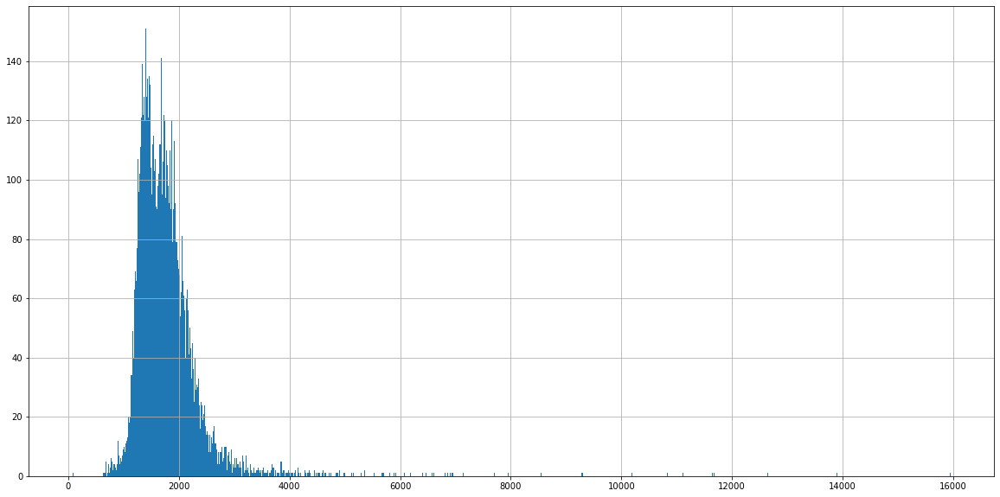

In [22]:
plt.figure(figsize=(20, 10))
data_whole_raw_AB.median().hist(bins=1000)
plt.show()
plt.close()

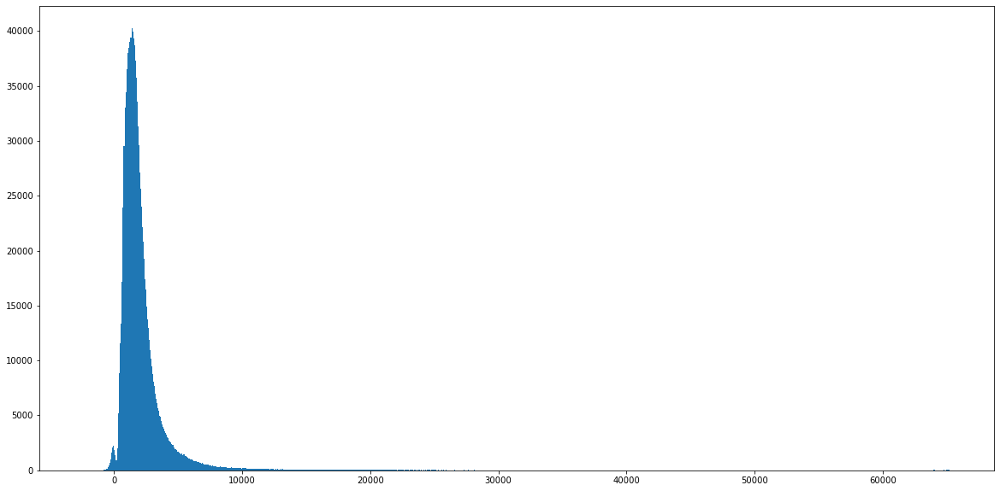

In [23]:
plt.figure(figsize=(20, 10))
plt.hist(np.ravel(data_whole_raw_AB.to_numpy()), bins=1000)
plt.show()
plt.close()

In [4]:
def substract_preimmunization_baseline(
    data: pd.DataFrame,
) -> pd.DataFrame:
    """ Substract baseline immunity and replace negative intensities.

    The baseline immunity (TimePointOrder = 1) is substracted from the signal intensities measured
    at post-immunization (TimePointOrder = 2, 3 and 4) for each sample `x_i`
    to focus on PfSPZ-CVac induced antibody responses.

    Parameters
    ----------
    data : pd.DataFrame
        Raw proteome data, n x m matrix (n = samples as rows, m = features as columns)

    Returns
    -------
    data_minusBS : pd.DataFrame
        Post-immunization data minus baseline immunity.
    """
    # baseline: preimmunization data I-1
    data_baseline = data.loc[data["TimePointOrder"] == 1, :].copy()
    data_baseline.reset_index(inplace=True, drop=True)

    # after immunization III 14
    data_III14 = data.loc[data["TimePointOrder"] == 2, :].copy()
    data_III14.reset_index(inplace=True, drop=True)

    # before re-infection C-1
    data_C1 = data.loc[data["TimePointOrder"] == 3, :].copy()
    data_C1.reset_index(inplace=True, drop=True)

    # after re-infection C+ 28
    data_C28 = data.loc[data["TimePointOrder"] == 4, :].copy()
    data_C28.reset_index(inplace=True, drop=True)

    start_indx = data.columns.get_loc("TimePointOrder") + 1

    # substract baseline
    data_III14.iloc[:, start_indx:] = data_III14.iloc[:, start_indx:].sub(
        data_baseline.iloc[:, start_indx:]
    )
    data_C1.iloc[:, start_indx:] = data_C1.iloc[:, start_indx:].sub(
        data_baseline.iloc[:, start_indx:]
    )
    data_C28.iloc[:, start_indx:] = data_C28.iloc[:, start_indx:].sub(
        data_baseline.iloc[:, start_indx:]
    )

    data_minusBS = pd.concat([data_III14, data_C1, data_C28], ignore_index=True)
    return data_minusBS

In [5]:
data_whole_subst = substract_preimmunization_baseline(data_whole_raw)
data_whole_subst.describe()

,group,Protection,Dose,TimePointOrder,mal_mito_3.iso1.exon1.amp1_4066,mal_mito_2.iso1.exon1.amp1_1466,mal_mito_1.iso1.exon1.amp1_3777,PFL2430c_484,PFL2215w_4059,PFL1550w_501,...,MAL8P1.320_1o1_4243,MAL8P1.156_187,MAL8P1.155_2o3_4890,MAL8P1.143_3o15_2092,MAL8P1.143_1o15_2416,MAL8P1.143_14o15_1450,MAL8P1.140_4049,MAL7P1.32_5037,MAL13P1.303e4s1_1829,MAL13P1.303e1s1_4421
count,120.000000,120.00000,120.000000,120.00000,120.000000,120.000000,120.000000,120.000000,120.000000,120.000000,...,120.000000,120.000000,120.000000,120.000000,120.000000,120.000000,120.000000,120.000000,120.000000,120.000000
mean,37.600000,0.45000,1.350000,3.00000,-35.075000,3.783333,-72.445833,1501.508333,356.804167,-39.466667,...,48.179167,244.216667,133.675000,1546.491667,130.720833,133.341667,126.379167,7606.300000,178.870833,5.612500
std,20.812246,0.49958,1.157003,0.81992,496.764594,1040.664560,450.786007,5568.797008,2947.688505,529.823372,...,654.826726,1012.112434,939.165853,3952.223528,790.576300,1303.674124,794.971029,16207.855592,1332.528975,543.210765
min,2.000000,0.00000,0.000000,2.00000,-1350.000000,-1733.500000,-1242.500000,-11328.500000,-2801.500000,-2012.000000,...,-1689.500000,-1218.000000,-1439.500000,-4059.000000,-1561.000000,-3113.500000,-2448.500000,-5414.500000,-1462.500000,-1635.000000
25%,21.000000,0.00000,0.000000,2.00000,-346.625000,-432.375000,-396.250000,-413.625000,-345.375000,-196.500000,...,-352.750000,-352.375000,-321.625000,-343.625000,-313.875000,-410.000000,-287.750000,-238.000000,-388.500000,-310.375000
50%,38.500000,0.00000,1.000000,3.00000,-60.500000,-38.750000,-104.000000,161.750000,-41.750000,8.500000,...,-2.750000,58.250000,-13.750000,202.750000,-33.250000,0.000000,41.250000,374.750000,-8.000000,-26.250000
75%,52.250000,1.00000,2.000000,4.00000,215.500000,279.500000,194.500000,1455.125000,554.625000,199.500000,...,339.125000,564.375000,415.375000,1918.000000,418.250000,398.750000,404.000000,6402.500000,407.250000,256.125000
max,73.000000,1.00000,3.000000,4.00000,2303.000000,9769.000000,1510.000000,33403.500000,30433.500000,1614.000000,...,1884.500000,7853.000000,7591.500000,19198.000000,3793.000000,8044.500000,3413.000000,60857.000000,12059.500000,1670.500000


In [6]:
from source.preprocessing import sort_proteome_data

data_whole_subst_sorted = sort_proteome_data(data_whole_subst)
data_whole_subst_sorted.describe()

,group,Protection,Dose,TimePointOrder,mal_mito_3.iso1.exon1.amp1_4066,mal_mito_2.iso1.exon1.amp1_1466,mal_mito_1.iso1.exon1.amp1_3777,PFL2430c_484,PFL2215w_4059,PFL1550w_501,...,MAL8P1.320_1o1_4243,MAL8P1.156_187,MAL8P1.155_2o3_4890,MAL8P1.143_3o15_2092,MAL8P1.143_1o15_2416,MAL8P1.143_14o15_1450,MAL8P1.140_4049,MAL7P1.32_5037,MAL13P1.303e4s1_1829,MAL13P1.303e1s1_4421
count,120.000000,120.00000,120.000000,120.00000,120.000000,120.000000,120.000000,120.000000,120.000000,120.000000,...,120.000000,120.000000,120.000000,120.000000,120.000000,120.000000,120.000000,120.000000,120.000000,120.000000
mean,37.600000,0.45000,1.350000,3.00000,-35.075000,3.783333,-72.445833,1501.508333,356.804167,-39.466667,...,48.179167,244.216667,133.675000,1546.491667,130.720833,133.341667,126.379167,7606.300000,178.870833,5.612500
std,20.812246,0.49958,1.157003,0.81992,496.764594,1040.664560,450.786007,5568.797008,2947.688505,529.823372,...,654.826726,1012.112434,939.165853,3952.223528,790.576300,1303.674124,794.971029,16207.855592,1332.528975,543.210765
min,2.000000,0.00000,0.000000,2.00000,-1350.000000,-1733.500000,-1242.500000,-11328.500000,-2801.500000,-2012.000000,...,-1689.500000,-1218.000000,-1439.500000,-4059.000000,-1561.000000,-3113.500000,-2448.500000,-5414.500000,-1462.500000,-1635.000000
25%,21.000000,0.00000,0.000000,2.00000,-346.625000,-432.375000,-396.250000,-413.625000,-345.375000,-196.500000,...,-352.750000,-352.375000,-321.625000,-343.625000,-313.875000,-410.000000,-287.750000,-238.000000,-388.500000,-310.375000
50%,38.500000,0.00000,1.000000,3.00000,-60.500000,-38.750000,-104.000000,161.750000,-41.750000,8.500000,...,-2.750000,58.250000,-13.750000,202.750000,-33.250000,0.000000,41.250000,374.750000,-8.000000,-26.250000
75%,52.250000,1.00000,2.000000,4.00000,215.500000,279.500000,194.500000,1455.125000,554.625000,199.500000,...,339.125000,564.375000,415.375000,1918.000000,418.250000,398.750000,404.000000,6402.500000,407.250000,256.125000
max,73.000000,1.00000,3.000000,4.00000,2303.000000,9769.000000,1510.000000,33403.500000,30433.500000,1614.000000,...,1884.500000,7853.000000,7591.500000,19198.000000,3793.000000,8044.500000,3413.000000,60857.000000,12059.500000,1670.500000


In [7]:
data_whole_subst_sorted

,Patient,group,Protection,Dose,TimePointOrder,mal_mito_3.iso1.exon1.amp1_4066,mal_mito_2.iso1.exon1.amp1_1466,mal_mito_1.iso1.exon1.amp1_3777,PFL2430c_484,PFL2215w_4059,...,MAL8P1.320_1o1_4243,MAL8P1.156_187,MAL8P1.155_2o3_4890,MAL8P1.143_3o15_2092,MAL8P1.143_1o15_2416,MAL8P1.143_14o15_1450,MAL8P1.140_4049,MAL7P1.32_5037,MAL13P1.303e4s1_1829,MAL13P1.303e1s1_4421
0,T2-002 III 14,2,1,1,2,131.0,82.0,124.0,13.0,-305.0,...,-99.0,-103.0,-228.0,2302.0,791.5,-473.0,-283.0,41117.0,-337.0,-291.0
1,T2-005 III 14,5,0,0,2,387.0,357.5,458.5,540.0,528.5,...,405.5,-7.0,579.0,654.0,198.5,-175.5,313.0,376.5,469.0,498.5
2,T2-006 III 14,6,1,1,2,915.5,770.5,1109.5,1636.5,2530.0,...,1884.5,1624.0,1831.0,1748.0,1642.5,1913.0,2033.0,9382.5,2073.0,1670.5
3,T2-007 III 14,7,0,1,2,125.0,175.0,142.0,1448.0,33.5,...,-149.0,168.5,-9.0,3947.5,324.0,361.5,-198.5,55542.0,74.0,-18.5
4,T2-010 III 14,10,0,2,2,89.5,252.0,223.0,1393.5,900.5,...,283.5,1830.0,1096.0,2529.0,1863.5,1375.5,1070.0,17834.5,1717.0,-288.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115,T2-067 C 28,67,1,2,4,-410.0,-198.5,-293.0,-1048.0,-1153.0,...,-534.5,-685.5,-677.0,-1013.5,-863.5,-596.5,-323.0,-584.0,-702.5,-408.0
116,T2-068 C 28,68,0,0,4,1854.0,1559.5,1510.0,-807.5,-1666.0,...,-1689.5,-973.0,-1439.5,-243.5,-1561.0,-2595.0,-2448.5,6162.5,-673.0,-1635.0
117,T2-071 C 28,71,1,3,4,-191.0,-255.5,-174.5,1015.0,-480.0,...,-517.5,732.5,39.5,4540.0,-132.0,5.5,-314.5,12637.0,-163.5,118.0
118,T2-072 C 28,72,1,3,4,-249.5,-304.0,-242.5,-1397.5,-424.0,...,-803.0,-421.0,-956.0,-679.0,-726.5,-1922.0,-142.0,-1491.0,-575.5,-338.0


In [8]:
data_whole_raw_T2_T3 = data_whole_raw.loc[data_whole_raw["TimePointOrder"].isin([2, 3]), :].copy(deep=True)
data_whole_raw_T2_T3

,Patient,group,Protection,Dose,TimePointOrder,mal_mito_3.iso1.exon1.amp1_4066,mal_mito_2.iso1.exon1.amp1_1466,mal_mito_1.iso1.exon1.amp1_3777,PFL2430c_484,PFL2215w_4059,...,MAL8P1.320_1o1_4243,MAL8P1.156_187,MAL8P1.155_2o3_4890,MAL8P1.143_3o15_2092,MAL8P1.143_1o15_2416,MAL8P1.143_14o15_1450,MAL8P1.140_4049,MAL7P1.32_5037,MAL13P1.303e4s1_1829,MAL13P1.303e1s1_4421
0,T2-002 C -1,2,1,1,3,996.0,977.5,930.0,3015.0,3020.5,...,2500.5,2266.0,2636.0,4172.0,2743.0,2535.0,2617.0,28020.0,2780.0,2408.0
3,T2-002 III 14,2,1,1,2,1021.0,1108.0,969.0,2919.0,3071.0,...,2699.0,2560.0,2437.0,4866.0,3050.5,2320.0,2239.0,44146.0,2238.0,2110.0
4,T2-005 C -1,5,0,0,3,2162.0,2807.0,2503.0,2445.0,2579.0,...,2322.0,3157.5,2125.0,2210.0,2525.5,2378.0,2421.5,3273.0,2401.5,2089.0
7,T2-005 III 14,5,0,0,2,1935.0,2559.0,2243.5,2892.0,2342.5,...,2410.5,2320.0,2087.5,2524.0,2132.5,1927.0,2334.5,3050.0,2341.0,2454.5
8,T2-006 C -1,6,1,1,3,1194.0,1429.0,1420.0,2139.5,3044.0,...,2165.0,1954.5,1988.5,2120.0,2060.5,2023.0,2111.0,10226.0,2312.0,1935.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
151,T2-071 III 14,71,1,3,2,1114.0,1371.0,1324.5,4908.5,1408.0,...,1123.0,2378.0,1146.5,8084.5,1092.0,1338.5,1129.0,24949.0,1132.0,969.0
152,T2-072 C -1,72,1,3,3,685.0,785.0,659.0,1246.5,1034.0,...,836.0,951.0,855.0,868.0,821.5,1268.0,862.5,1111.0,860.0,709.0
155,T2-072 III 14,72,1,3,2,584.0,613.0,506.0,1239.5,1053.0,...,1269.0,871.0,1218.0,1015.5,959.0,1318.5,970.5,1243.0,901.0,885.0
156,T2-073 C -1,73,1,3,3,1546.0,1635.0,1439.0,6197.0,1967.5,...,1639.0,2723.0,1610.0,3157.0,1626.5,1604.0,1855.5,2718.5,1554.0,1355.0


In [9]:
data_whole_subst_sorted_T2_T3 = data_whole_subst_sorted.loc[data_whole_subst_sorted["TimePointOrder"].isin([2, 3]), :].copy(deep=True)
data_whole_subst_sorted_T2_T3

,Patient,group,Protection,Dose,TimePointOrder,mal_mito_3.iso1.exon1.amp1_4066,mal_mito_2.iso1.exon1.amp1_1466,mal_mito_1.iso1.exon1.amp1_3777,PFL2430c_484,PFL2215w_4059,...,MAL8P1.320_1o1_4243,MAL8P1.156_187,MAL8P1.155_2o3_4890,MAL8P1.143_3o15_2092,MAL8P1.143_1o15_2416,MAL8P1.143_14o15_1450,MAL8P1.140_4049,MAL7P1.32_5037,MAL13P1.303e4s1_1829,MAL13P1.303e1s1_4421
0,T2-002 III 14,2,1,1,2,131.0,82.0,124.0,13.0,-305.0,...,-99.0,-103.0,-228.0,2302.0,791.5,-473.0,-283.0,41117.0,-337.0,-291.0
1,T2-005 III 14,5,0,0,2,387.0,357.5,458.5,540.0,528.5,...,405.5,-7.0,579.0,654.0,198.5,-175.5,313.0,376.5,469.0,498.5
2,T2-006 III 14,6,1,1,2,915.5,770.5,1109.5,1636.5,2530.0,...,1884.5,1624.0,1831.0,1748.0,1642.5,1913.0,2033.0,9382.5,2073.0,1670.5
3,T2-007 III 14,7,0,1,2,125.0,175.0,142.0,1448.0,33.5,...,-149.0,168.5,-9.0,3947.5,324.0,361.5,-198.5,55542.0,74.0,-18.5
4,T2-010 III 14,10,0,2,2,89.5,252.0,223.0,1393.5,900.5,...,283.5,1830.0,1096.0,2529.0,1863.5,1375.5,1070.0,17834.5,1717.0,-288.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75,T2-067 C -1,67,1,2,3,-551.0,-86.5,-487.0,-1430.5,-1974.0,...,-778.5,-1093.5,-930.0,-1227.5,-1214.5,-694.5,-235.0,-820.0,-1289.0,-806.0
76,T2-068 C -1,68,0,0,3,84.0,-29.0,-111.0,2110.0,594.0,...,1497.5,-779.0,226.5,2400.0,96.5,1079.0,1876.5,1103.0,923.0,1339.5
77,T2-071 C -1,71,1,3,3,-349.5,-288.0,-243.5,2343.0,-423.5,...,-646.0,744.0,-174.0,5934.0,-36.5,120.0,-409.0,19421.0,-340.0,-250.0
78,T2-072 C -1,72,1,3,3,-425.0,-420.0,-427.0,-1601.5,-901.0,...,-1038.0,-497.0,-959.0,-713.0,-753.5,-2511.0,-504.5,-1736.0,-711.5,-569.0


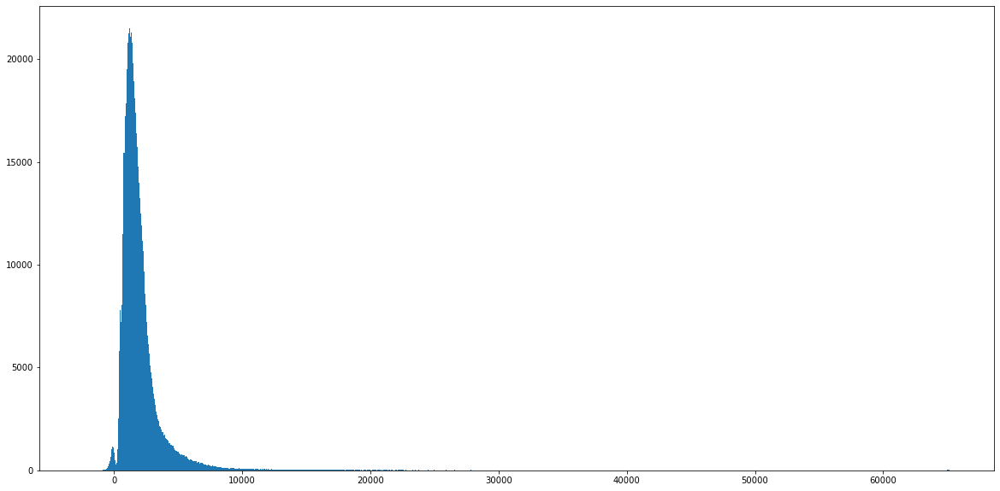

In [10]:
plt.figure(figsize=(20, 10))
plt.hist(np.ravel(data_whole_raw_T2_T3.iloc[:, 5:].to_numpy()), bins=1000)
plt.show()
plt.close()

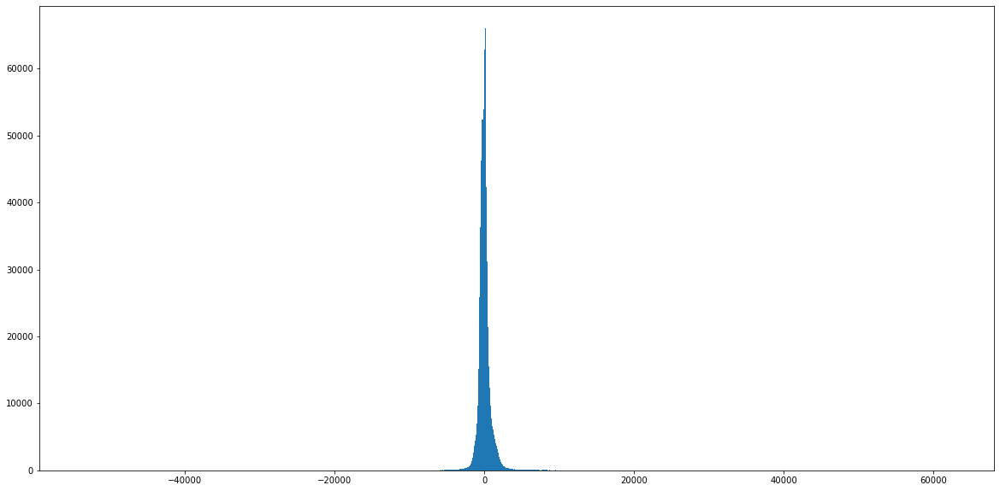

In [11]:
plt.figure(figsize=(20, 10))
plt.hist(np.ravel(data_whole_subst_sorted_T2_T3.iloc[:, 5:].to_numpy()), bins=1000)
plt.show()
plt.close()

In [12]:
def normalization(
    X: pd.DataFrame,
) -> pd.DataFrame:
    """ Normalization.

    The antibody signal intensities `x` are transformed by the inverse hyperbolic sine,
    i.e., `arsinh(x) = ln(x + sqrt(x^2 + 1))`.

    Parameters
    ----------
    X : pd.DataFrame
        Raw proteome data, n x m matrix (n = samples as rows, m = features as columns).

    Returns
    -------
    data : pd.DataFrame
        Normalized proteome data.
    """
    data = copy.deepcopy(X)

    start_indx = data.columns.get_loc("TimePointOrder") + 1

    # for col in data.columns[start_indx:]:
    #     data[col] = data[col] - data[col].mean()
    data[data.columns[start_indx:]] = np.log(data[data.columns[start_indx:]].to_numpy() + np.sqrt(np.square(data[data.columns[start_indx:]]) + 1))
    return data

In [46]:
def normalization_(
    X: pd.DataFrame,
) -> pd.DataFrame:
    """ Normalization.

    The antibody signal intensities `x` are transformed by the inverse hyperbolic sine,
    i.e., `arsinh(x) = ln(x + sqrt(x^2 + 1))`.

    Parameters
    ----------
    X : pd.DataFrame
        Raw proteome data, n x m matrix (n = samples as rows, m = features as columns).

    Returns
    -------
    data : pd.DataFrame
        Normalized proteome data.
    """
    data = copy.deepcopy(X)

    start_indx = data.columns.get_loc("TimePointOrder") + 1

    # for col in data.columns[start_indx:]:
    #     data[col] = data[col] - data[col].mean()
    data[data.columns[start_indx:]] = np.arcsinh(data[data.columns[start_indx:]].to_numpy())
    return data

In [13]:
data_whole_subst_sorted_T2_T3_norm = normalization(data_whole_subst_sorted_T2_T3)
data_whole_subst_sorted_T2_T3_norm.describe()

,group,Protection,Dose,TimePointOrder,mal_mito_3.iso1.exon1.amp1_4066,mal_mito_2.iso1.exon1.amp1_1466,mal_mito_1.iso1.exon1.amp1_3777,PFL2430c_484,PFL2215w_4059,PFL1550w_501,...,MAL8P1.320_1o1_4243,MAL8P1.156_187,MAL8P1.155_2o3_4890,MAL8P1.143_3o15_2092,MAL8P1.143_1o15_2416,MAL8P1.143_14o15_1450,MAL8P1.140_4049,MAL7P1.32_5037,MAL13P1.303e4s1_1829,MAL13P1.303e1s1_4421
count,80.000000,80.000000,80.000000,80.000000,80.000000,80.000000,80.000000,80.000000,80.000000,80.000000,...,80.000000,80.000000,80.000000,80.000000,80.000000,80.000000,80.000000,80.000000,80.000000,80.000000
mean,37.600000,0.450000,1.350000,2.500000,-0.823923,-1.188637,-1.348200,0.332524,-0.773910,-0.103477,...,-0.619360,0.693394,-0.798605,1.147665,-0.487828,-0.495945,-0.172119,2.053592,-0.391451,-0.979074
std,20.856107,0.500633,1.159441,0.503155,6.259431,6.353737,6.196216,7.400527,6.638704,5.901355,...,6.522270,6.512529,6.363496,7.300614,6.656959,6.759481,6.508611,7.699495,6.597682,6.251773
min,2.000000,0.000000,0.000000,2.000000,-7.901007,-8.151045,-7.818028,-10.028224,-8.631057,-8.300032,...,-7.832411,-7.798113,-7.793175,-9.001839,-7.822845,-8.736650,-8.028129,-9.289983,-7.981050,-8.062118
25%,21.000000,0.000000,0.000000,2.000000,-6.710012,-6.878585,-6.809041,-6.994949,-6.574974,-6.024045,...,-6.497368,-6.668535,-6.466530,-6.666872,-6.525538,-6.741975,-6.396304,-6.309842,-6.644424,-6.438135
50%,38.500000,0.000000,1.000000,2.500000,-5.398091,-5.534272,-5.346949,2.677143,-5.123716,-0.281131,...,-4.850135,4.030759,-4.435426,5.264553,-5.194098,-5.084885,-3.241619,5.410669,-3.470763,-4.615202
75%,52.250000,1.000000,2.000000,3.000000,5.725193,5.947161,5.800573,7.506344,6.950309,5.875321,...,6.349029,6.837389,6.400130,7.991276,6.683633,6.329681,6.670433,8.747693,6.573170,6.032466
max,73.000000,1.000000,3.000000,3.000000,7.689829,7.787382,7.762171,10.556542,8.656955,8.079618,...,8.234565,8.695841,8.408494,9.812632,8.934060,8.866300,8.415825,11.696080,8.765615,8.114026


In [51]:
np.allclose(normalization(data_whole_subst_sorted_T2_T3).iloc[:, 5:].to_numpy(), normalization_(data_whole_subst_sorted_T2_T3).iloc[:, 5:].to_numpy())

True

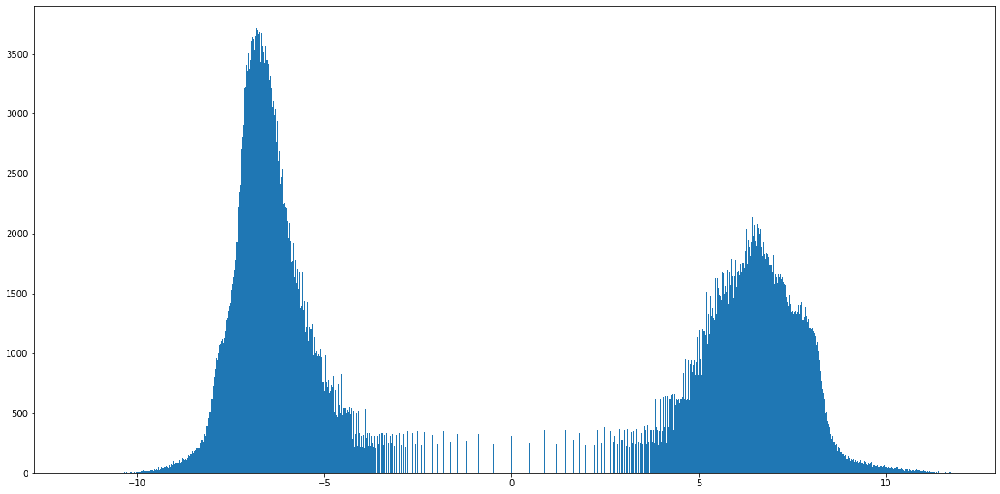

In [14]:
plt.figure(figsize=(20, 10))
plt.hist(np.ravel(data_whole_subst_sorted_T2_T3_norm.iloc[:, 5:].to_numpy()), bins=1000)
plt.show()
plt.close()

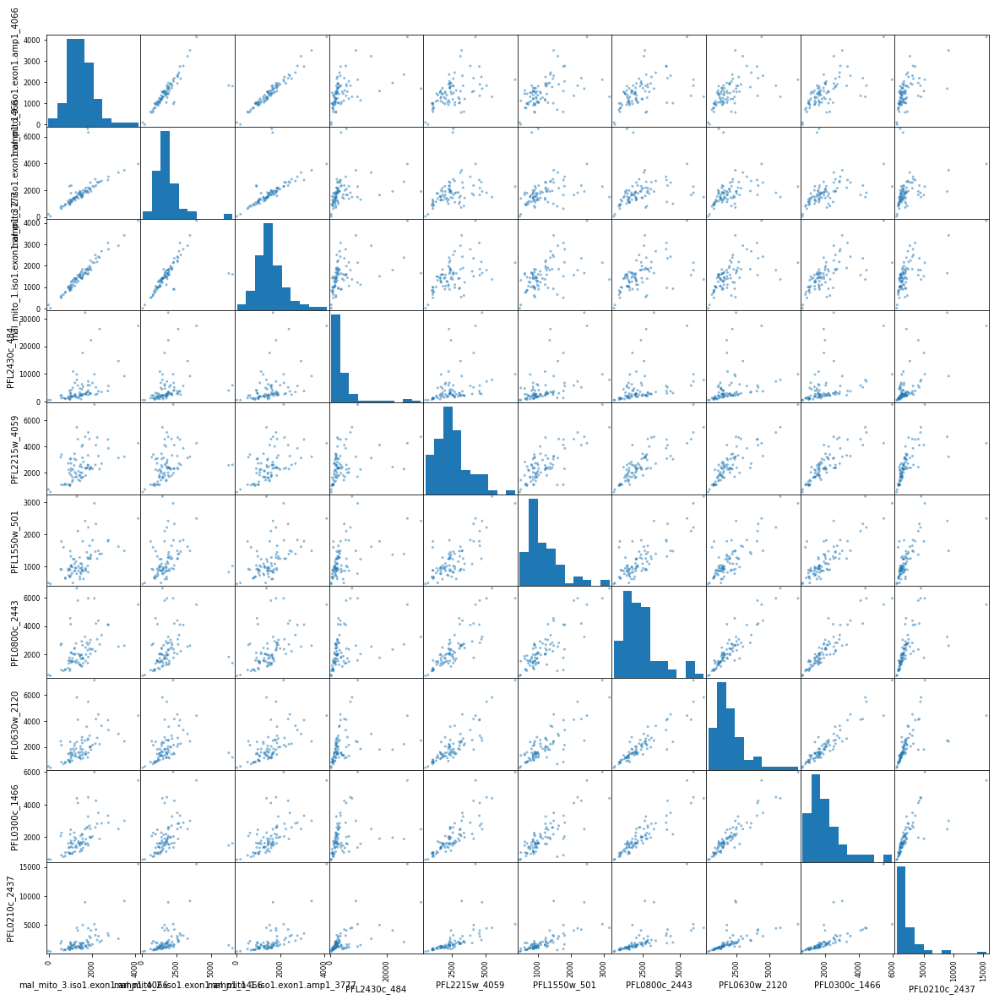

In [15]:
pd.plotting.scatter_matrix(data_whole_raw_T2_T3.iloc[:, 5:15], figsize=(20, 20))
plt.show()
plt.close()

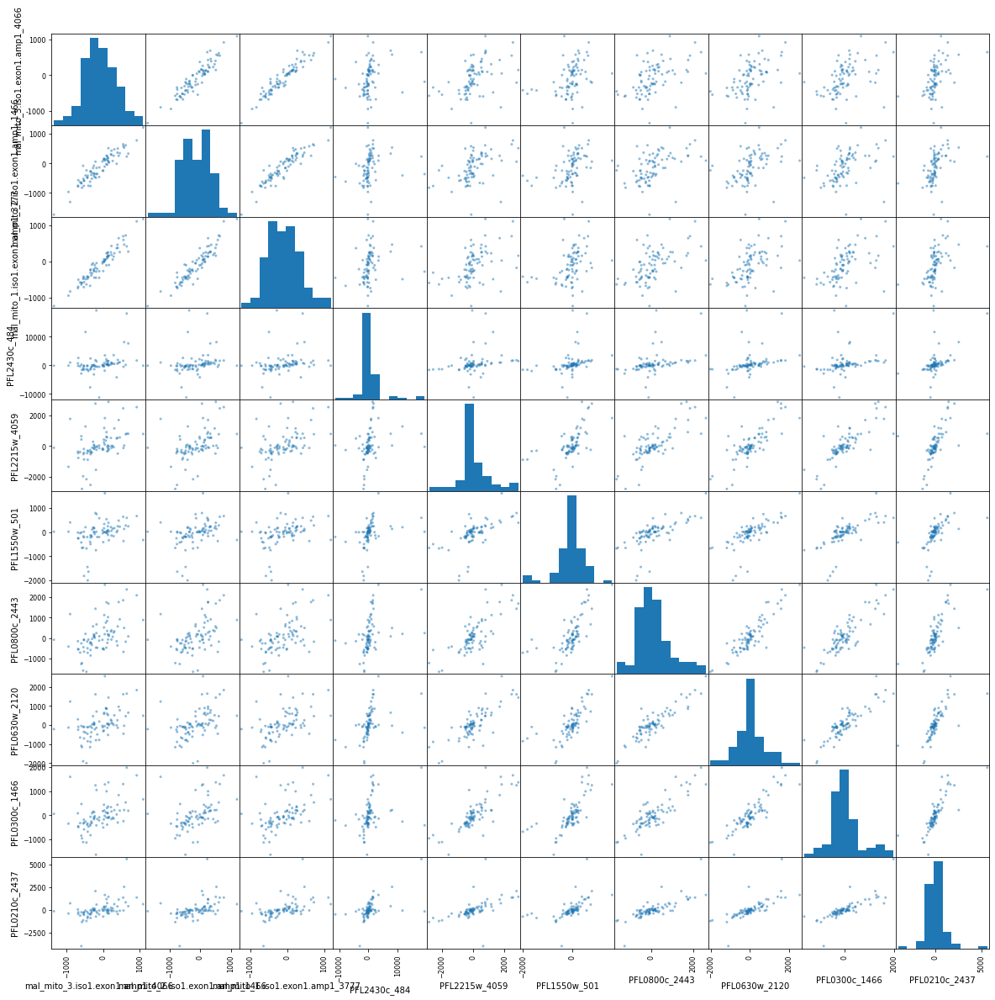

In [16]:
pd.plotting.scatter_matrix(data_whole_subst_sorted_T2_T3.iloc[:, 5:15], figsize=(20, 20))
plt.show()
plt.close()

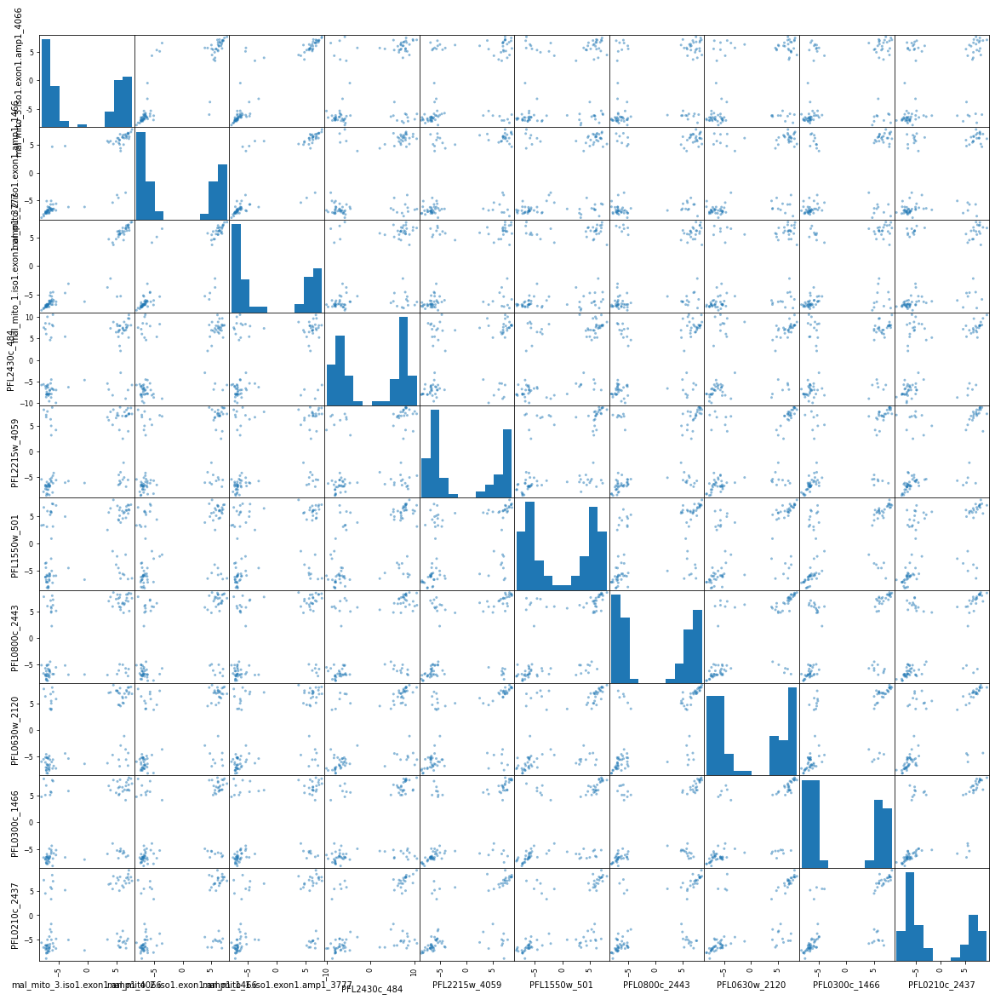

In [17]:
pd.plotting.scatter_matrix(data_whole_subst_sorted_T2_T3_norm.iloc[:, 5:15], figsize=(20, 20))
plt.show()
plt.close()

In [18]:
corr_T2_T3 = data_whole_subst_sorted_T2_T3_norm.iloc[:, 5:].corr(method='spearman')

# Ensure the correlation matrix is symmetric
dummy = corr_T2_T3.to_numpy()
dummy = (dummy + dummy.T) / 2.
np.fill_diagonal(dummy, 1.)
corr_T2_T3.loc[:, :] = dummy

corr_T2_T3.describe()

,mal_mito_3.iso1.exon1.amp1_4066,mal_mito_2.iso1.exon1.amp1_1466,mal_mito_1.iso1.exon1.amp1_3777,PFL2430c_484,PFL2215w_4059,PFL1550w_501,PFL0800c_2443,PFL0630w_2120,PFL0300c_1466,PFL0210c_2437,...,MAL8P1.320_1o1_4243,MAL8P1.156_187,MAL8P1.155_2o3_4890,MAL8P1.143_3o15_2092,MAL8P1.143_1o15_2416,MAL8P1.143_14o15_1450,MAL8P1.140_4049,MAL7P1.32_5037,MAL13P1.303e4s1_1829,MAL13P1.303e1s1_4421
count,7455.000000,7455.000000,7455.000000,7455.000000,7455.000000,7455.000000,7455.000000,7455.000000,7455.000000,7455.000000,...,7455.000000,7455.000000,7455.000000,7455.000000,7455.000000,7455.000000,7455.000000,7455.000000,7455.000000,7455.000000
mean,0.680705,0.707937,0.689264,0.523412,0.601846,0.556750,0.595554,0.639807,0.633013,0.634008,...,0.637482,0.493164,0.693214,0.565304,0.655597,0.617663,0.648720,0.465743,0.711206,0.638845
std,0.185686,0.181310,0.185872,0.109289,0.114449,0.173548,0.148058,0.164032,0.153704,0.133948,...,0.156851,0.157540,0.134653,0.101727,0.126144,0.140018,0.149151,0.114844,0.139023,0.154618
min,-0.098266,-0.147833,-0.129001,0.122058,0.143051,-0.012330,0.003926,0.032724,0.060455,0.060607,...,-0.053728,-0.026278,0.045805,0.135268,0.103599,0.033884,-0.008322,0.107848,0.024215,-0.007865
25%,0.544973,0.573371,0.555854,0.439044,0.515822,0.405197,0.487060,0.527454,0.522470,0.547558,...,0.543403,0.349055,0.606810,0.490220,0.567577,0.513728,0.563601,0.384115,0.632224,0.545686
50%,0.637439,0.660759,0.646597,0.513716,0.580457,0.528004,0.565744,0.598917,0.597725,0.619905,...,0.609540,0.497064,0.677090,0.554382,0.639049,0.575941,0.624243,0.448913,0.695203,0.610727
75%,0.873125,0.904500,0.878913,0.614707,0.710121,0.728927,0.731441,0.798366,0.785131,0.753076,...,0.775948,0.633685,0.819278,0.638725,0.770026,0.752979,0.779188,0.519487,0.837626,0.780287
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


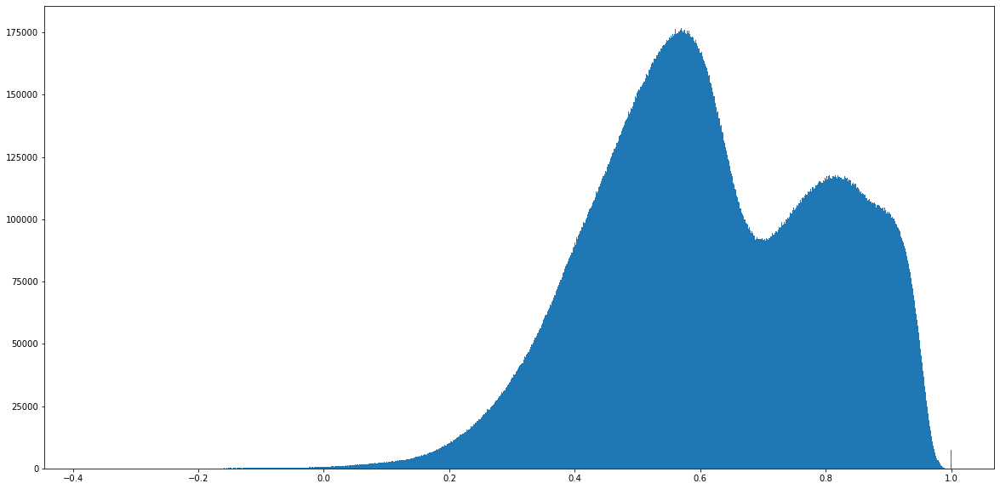

In [19]:
plt.figure(figsize=(20, 10))
plt.hist(np.ravel(corr_T2_T3.iloc[:, 5:].to_numpy()), bins=1000)
plt.show()
plt.close()

In [20]:
corr_T2_T3_abs = corr_T2_T3.abs()
corr_T2_T3_abs

,mal_mito_3.iso1.exon1.amp1_4066,mal_mito_2.iso1.exon1.amp1_1466,mal_mito_1.iso1.exon1.amp1_3777,PFL2430c_484,PFL2215w_4059,PFL1550w_501,PFL0800c_2443,PFL0630w_2120,PFL0300c_1466,PFL0210c_2437,...,MAL8P1.320_1o1_4243,MAL8P1.156_187,MAL8P1.155_2o3_4890,MAL8P1.143_3o15_2092,MAL8P1.143_1o15_2416,MAL8P1.143_14o15_1450,MAL8P1.140_4049,MAL7P1.32_5037,MAL13P1.303e4s1_1829,MAL13P1.303e1s1_4421
mal_mito_3.iso1.exon1.amp1_4066,1.000000,0.919737,0.949383,0.437482,0.552550,0.453472,0.542584,0.543475,0.555832,0.565439,...,0.599058,0.351315,0.647746,0.515169,0.608829,0.546390,0.615557,0.422365,0.672691,0.577945
mal_mito_2.iso1.exon1.amp1_1466,0.919737,1.000000,0.926023,0.503352,0.568302,0.500132,0.553051,0.583419,0.588732,0.622425,...,0.596503,0.416564,0.695191,0.544342,0.645433,0.582888,0.629598,0.472917,0.709728,0.592256
mal_mito_1.iso1.exon1.amp1_3777,0.949383,0.926023,1.000000,0.448501,0.537118,0.477666,0.548062,0.582615,0.610996,0.613313,...,0.591908,0.389805,0.668294,0.529215,0.641877,0.559733,0.601732,0.427816,0.683119,0.600326
PFL2430c_484,0.437482,0.503352,0.448501,1.000000,0.504132,0.645562,0.597120,0.645151,0.564915,0.608958,...,0.555363,0.474886,0.649468,0.808444,0.669812,0.579020,0.506379,0.738108,0.641327,0.503285
PFL2215w_4059,0.552550,0.568302,0.537118,0.504132,1.000000,0.671683,0.667874,0.716011,0.788685,0.764594,...,0.719297,0.672005,0.762348,0.537832,0.746708,0.726462,0.717629,0.481478,0.776099,0.728177
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MAL8P1.143_14o15_1450,0.546390,0.582888,0.559733,0.579020,0.726462,0.707470,0.743792,0.770539,0.808390,0.740933,...,0.782088,0.678403,0.827776,0.599476,0.753896,1.000000,0.767339,0.507551,0.835795,0.774583
MAL8P1.140_4049,0.615557,0.629598,0.601732,0.506379,0.717629,0.685275,0.669769,0.786812,0.769036,0.705470,...,0.897355,0.582309,0.814407,0.601894,0.731760,0.767339,1.000000,0.421688,0.864902,0.885102
MAL7P1.32_5037,0.422365,0.472917,0.427816,0.738108,0.481478,0.536387,0.489117,0.449888,0.489566,0.457477,...,0.393338,0.484054,0.546165,0.846107,0.583293,0.507551,0.421688,1.000000,0.504422,0.415992
MAL13P1.303e4s1_1829,0.672691,0.709728,0.683119,0.641327,0.776099,0.801845,0.837605,0.894391,0.832991,0.844391,...,0.848193,0.635927,0.906410,0.647519,0.884768,0.835795,0.864902,0.504422,1.000000,0.860366


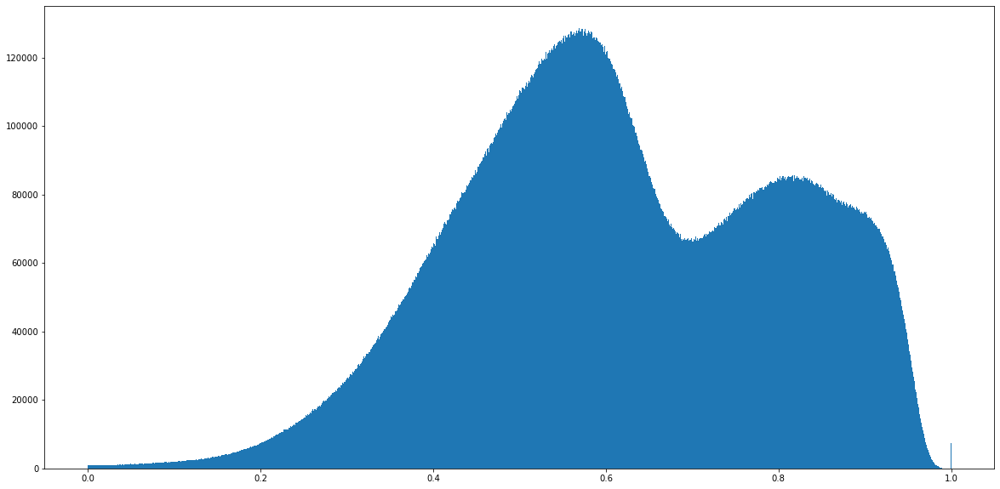

In [21]:
plt.figure(figsize=(20, 10))
plt.hist(np.ravel(corr_T2_T3_abs.iloc[:, 5:].to_numpy()), bins=1000)
plt.show()
plt.close()

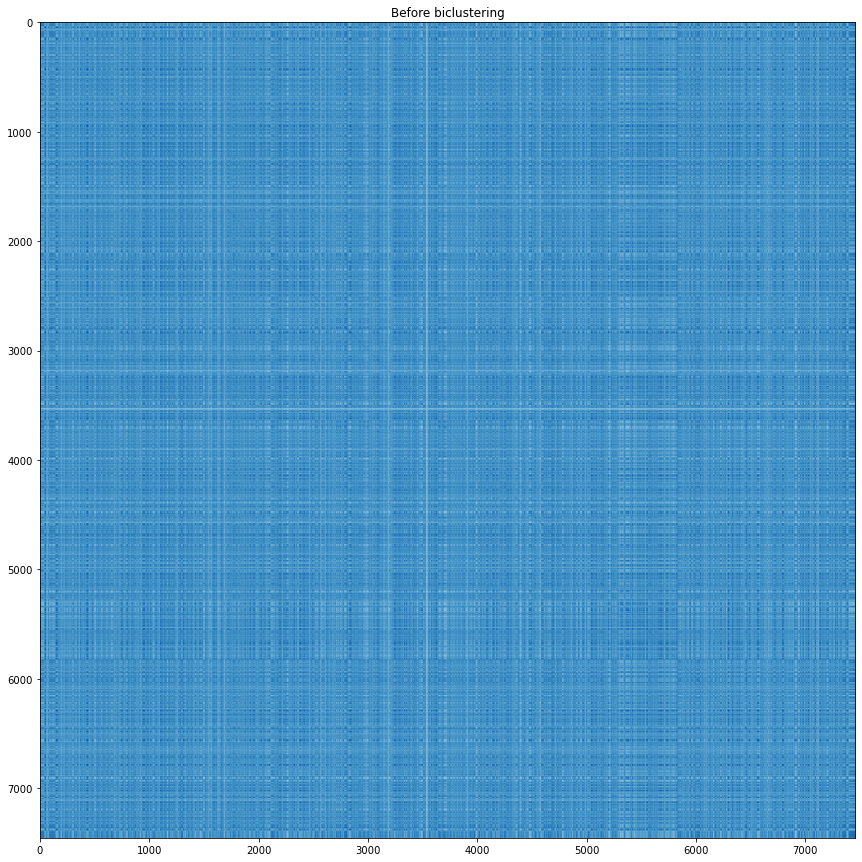

In [22]:
plt.figure(figsize=(15, 15))
plt.imshow(corr_T2_T3_abs, cmap='Blues', vmin=0, vmax=1)
plt.title("Before biclustering")

plt.show()
plt.close()

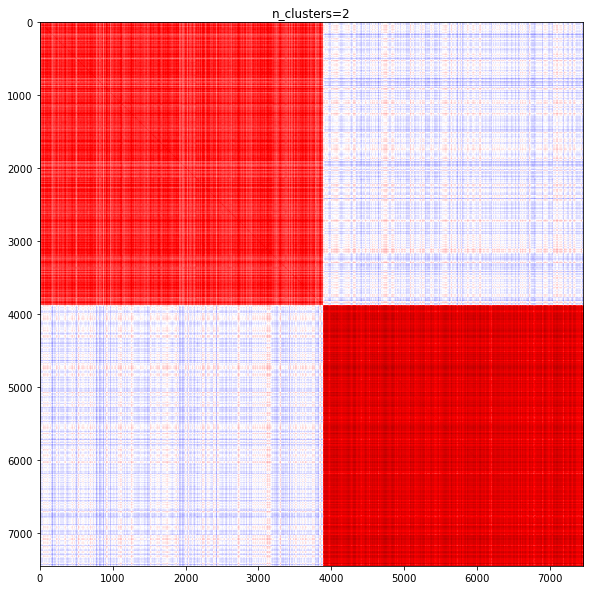

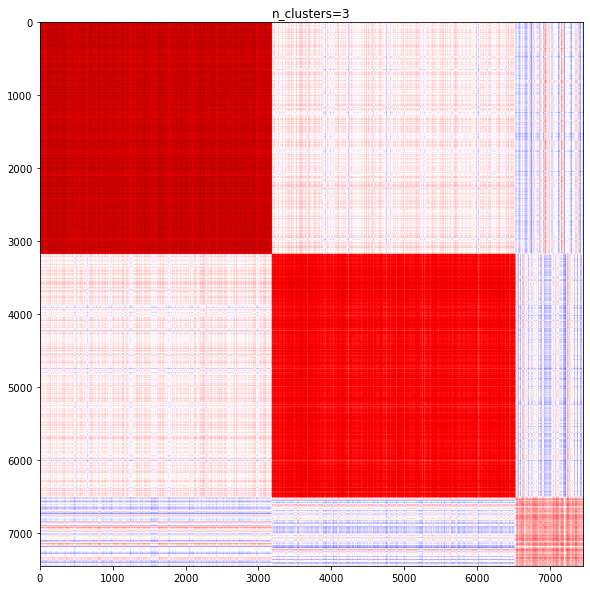

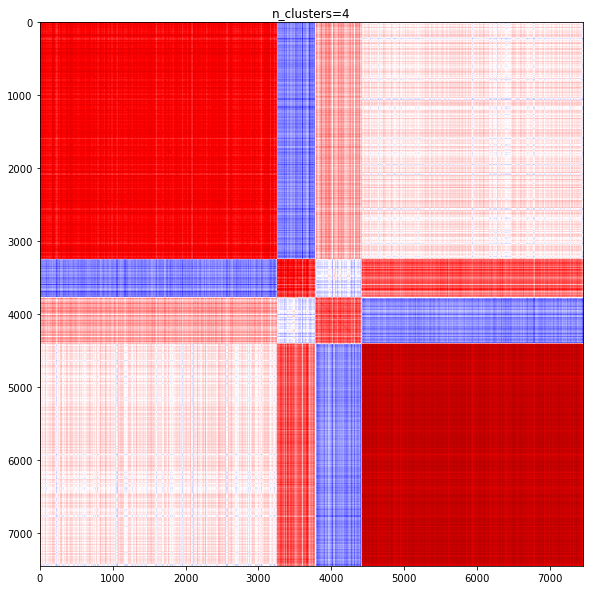

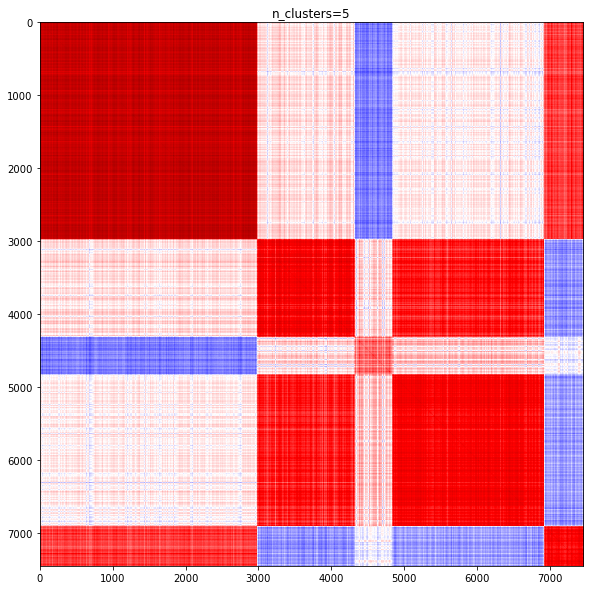

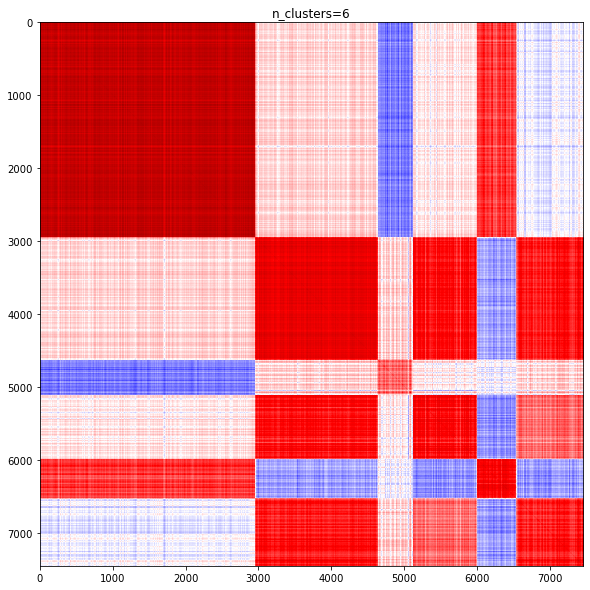

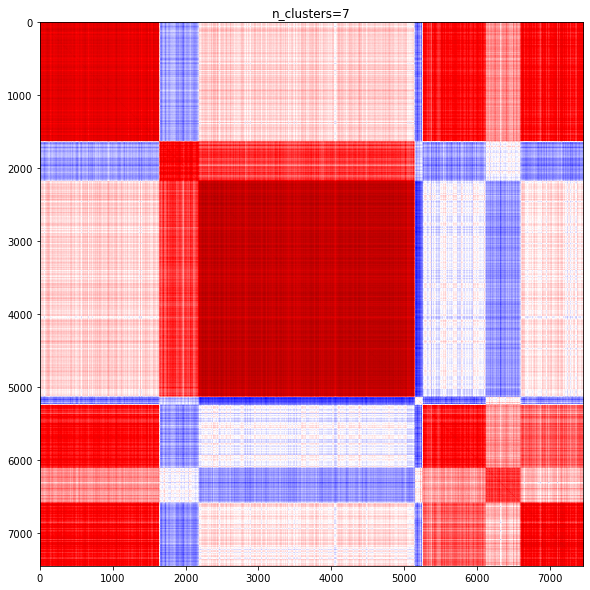

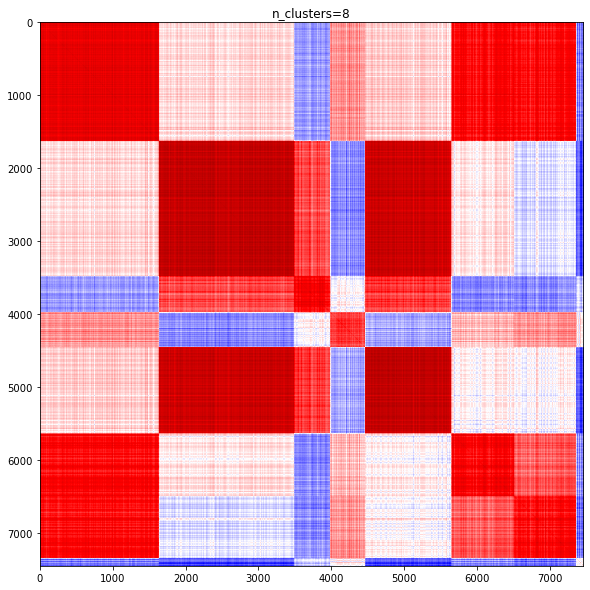

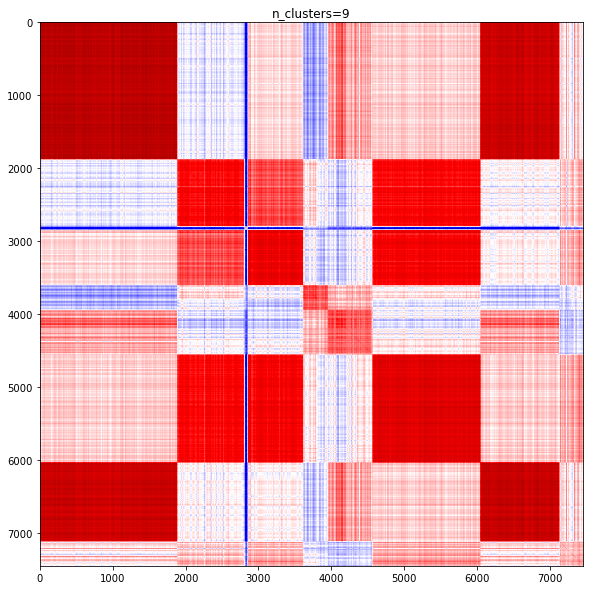

In [26]:
for n in range(2, 10):
    model = SpectralCoclustering(n_clusters=n, random_state=0)
    model.fit(corr_T2_T3_abs.to_numpy())

    fit_data = corr_T2_T3_abs.to_numpy()[np.argsort(model.row_labels_)]
    fit_data = fit_data[:, np.argsort(model.column_labels_)]

    plt.figure(figsize=(10, 10))
    plt.imshow(fit_data, cmap='seismic', vmin=0, vmax=1)
    plt.title(f"n_clusters={n}")

    plt.show()
    plt.close()

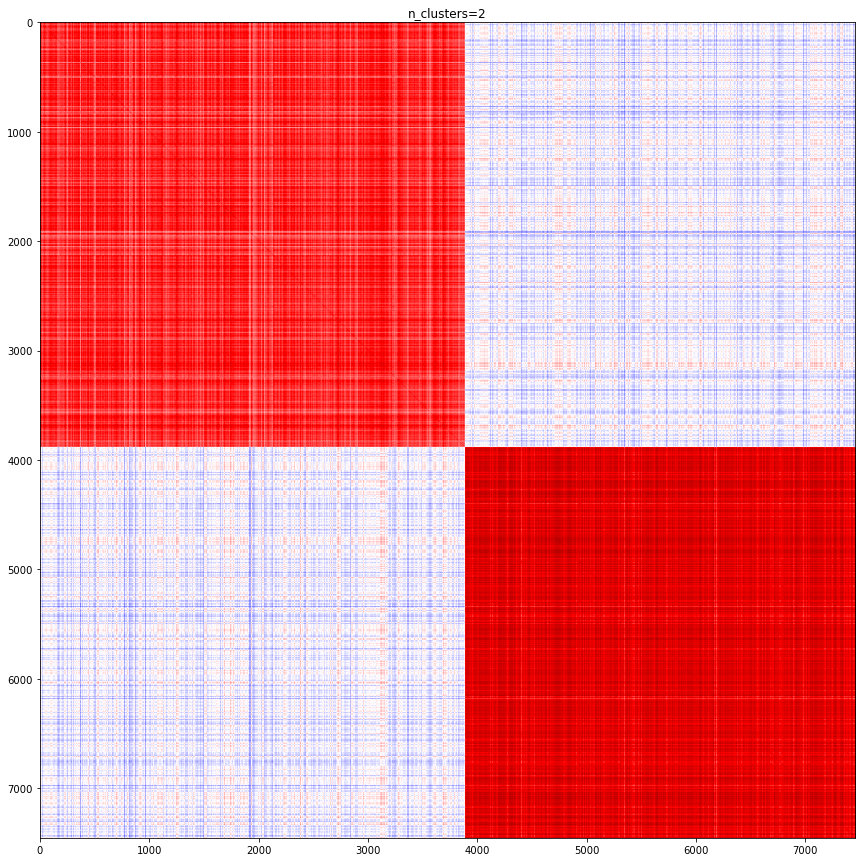

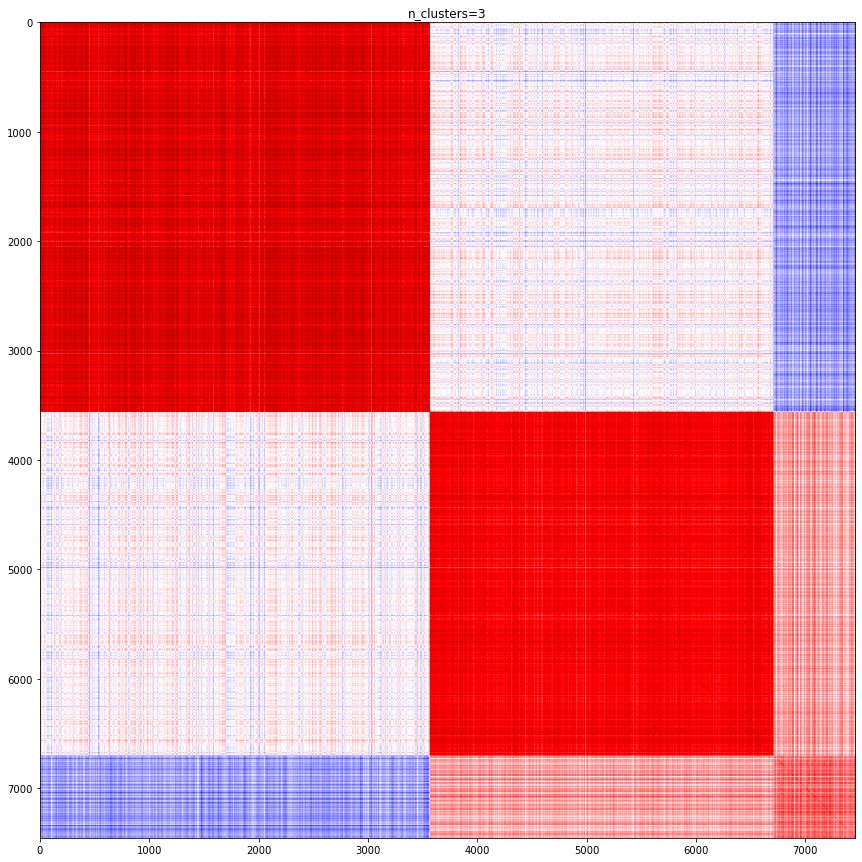

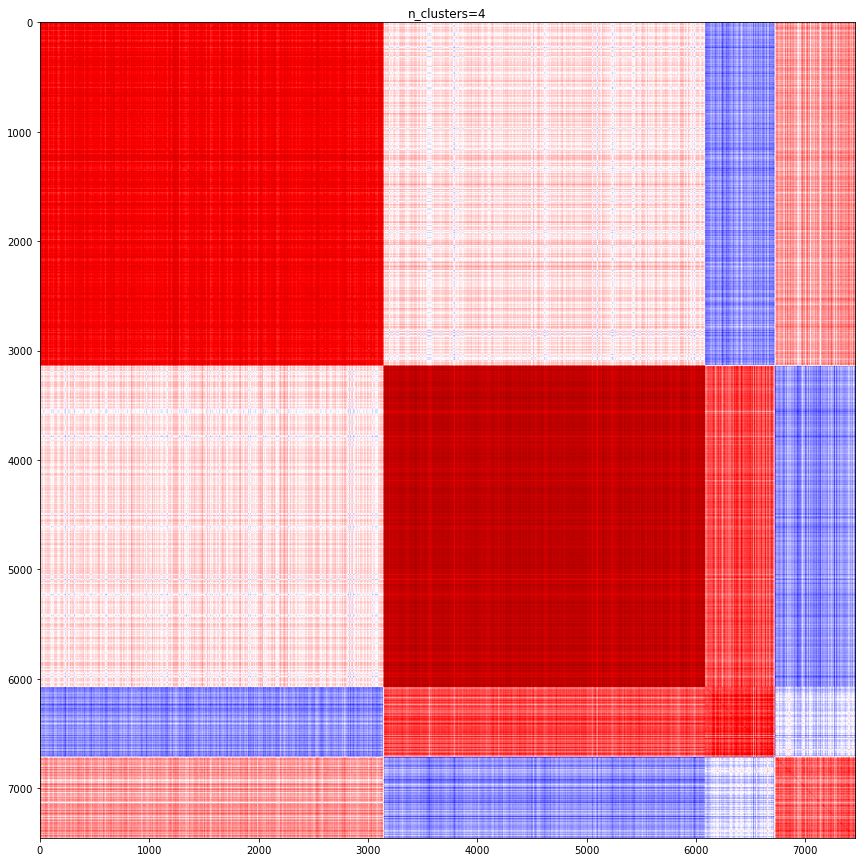

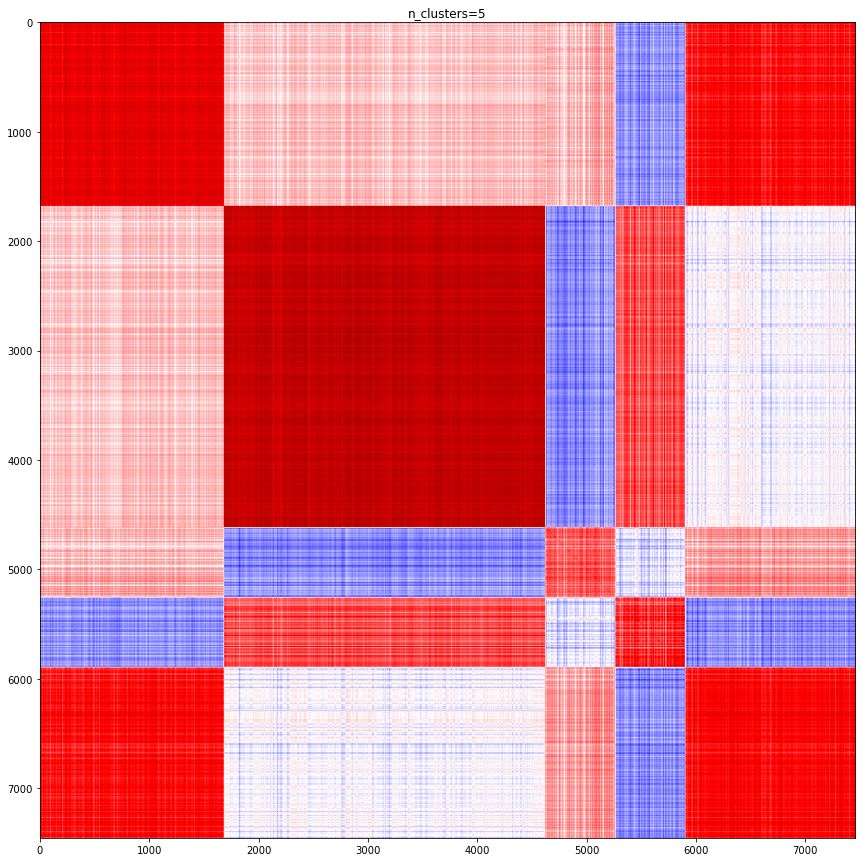

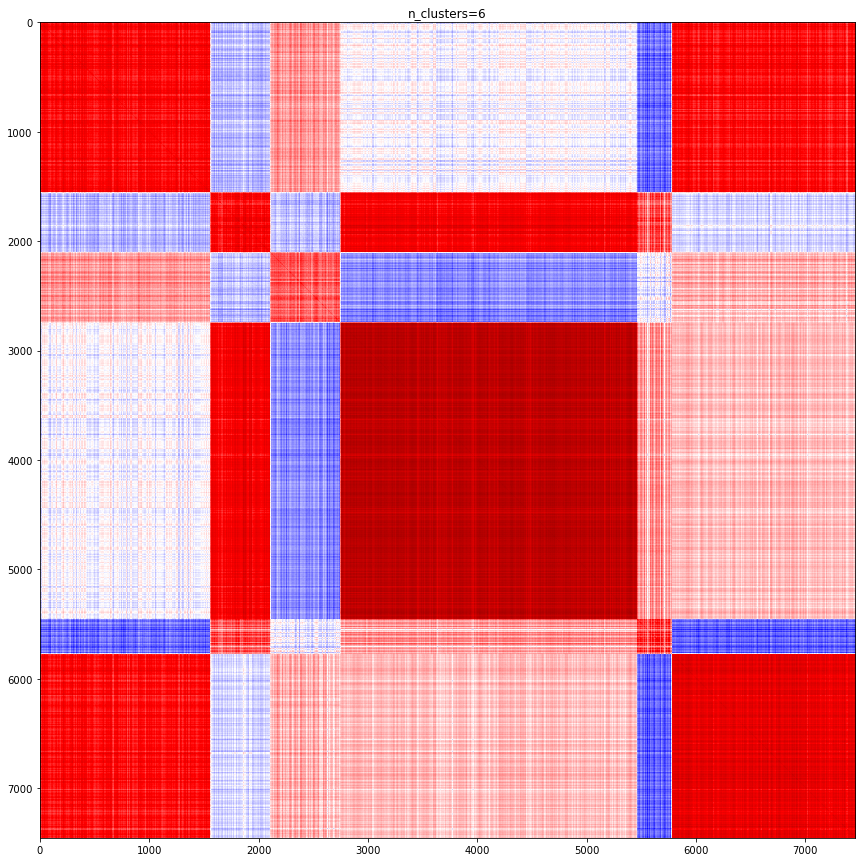

...

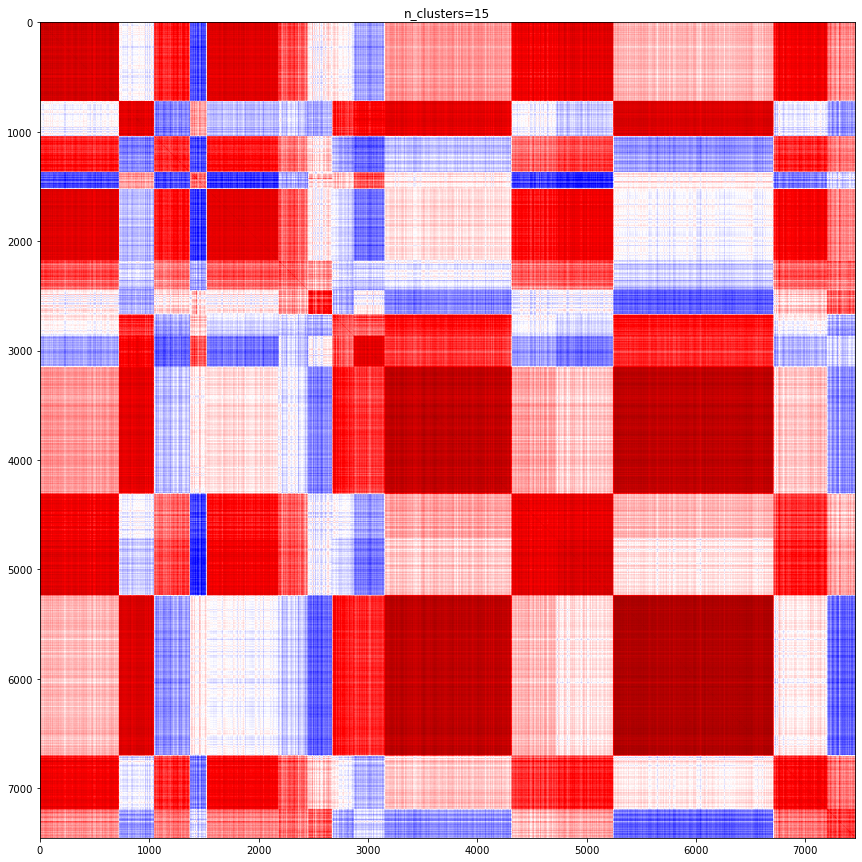

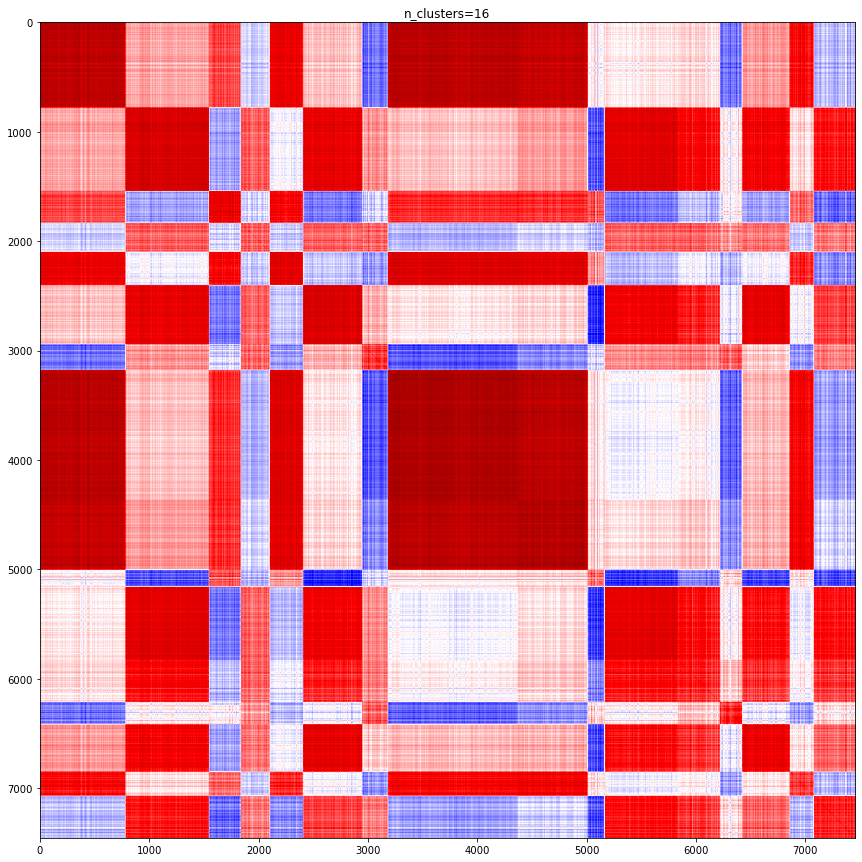

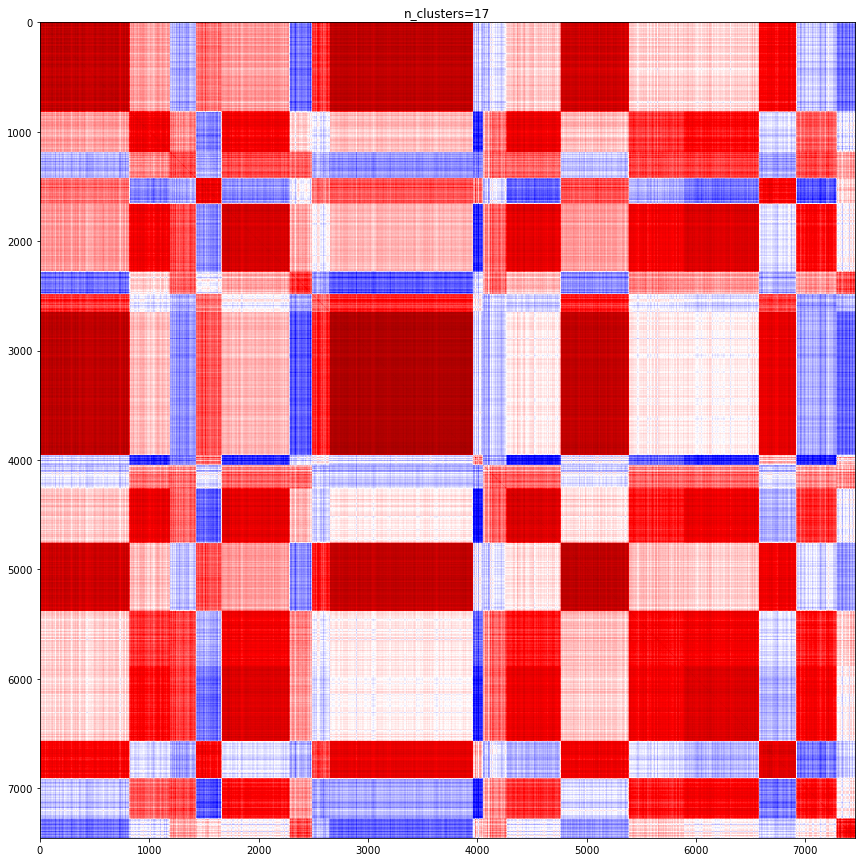

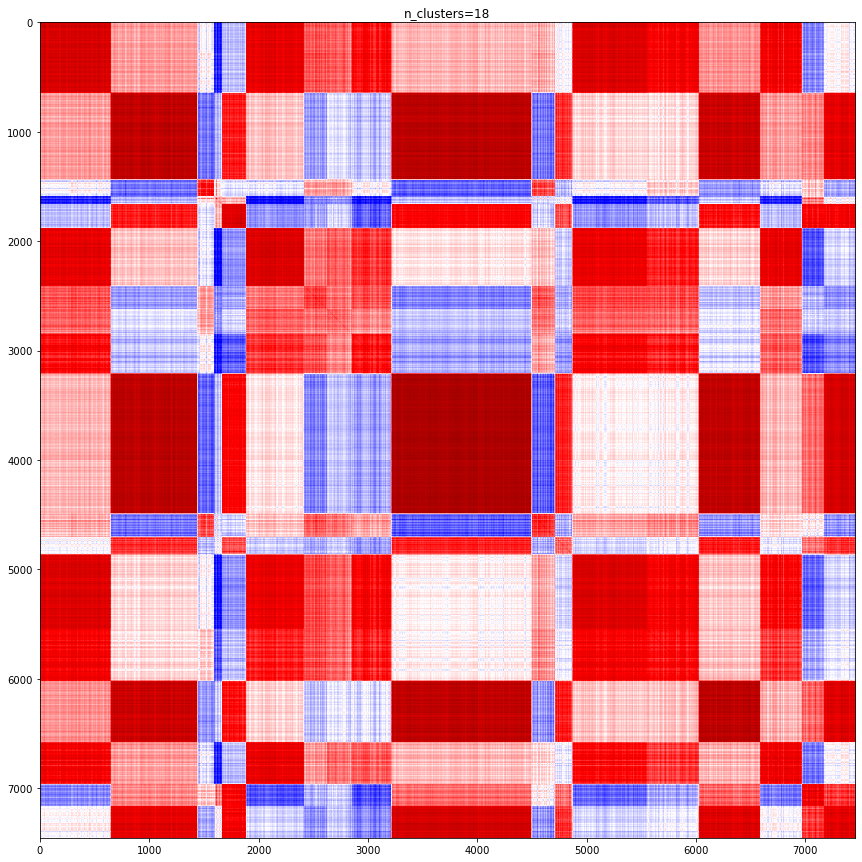

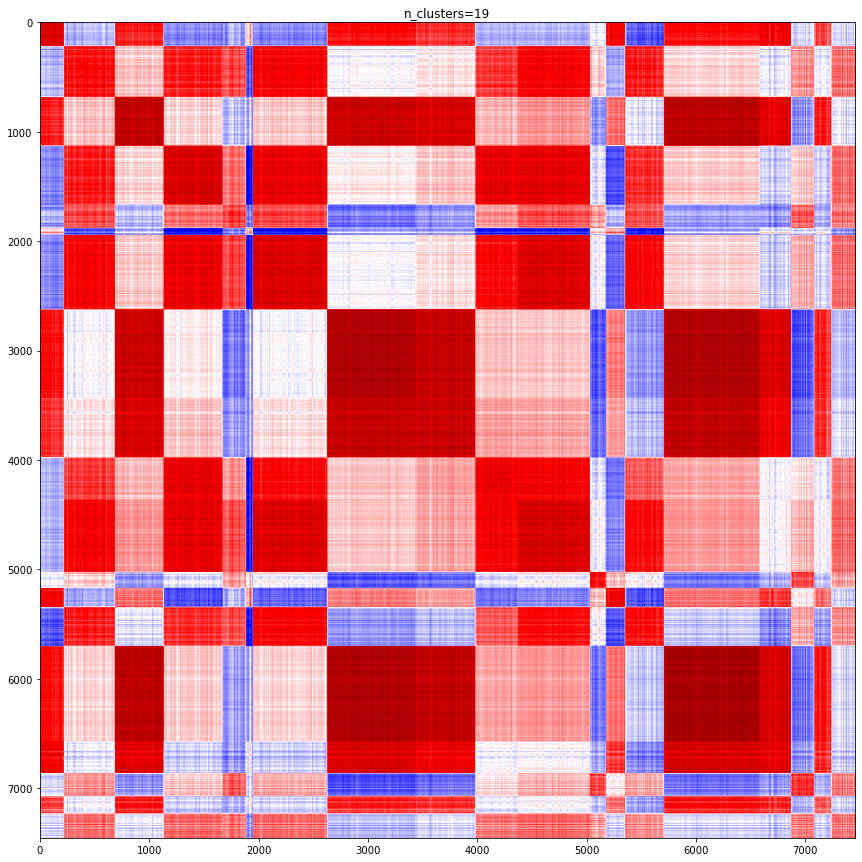

In [28]:
for n in range(2, 20):
    model = SpectralBiclustering(n_clusters=n, method='log', random_state=0)
    model.fit(corr_T2_T3_abs.to_numpy())

    fit_data = corr_T2_T3_abs.to_numpy()[np.argsort(model.row_labels_)]
    fit_data = fit_data[:, np.argsort(model.column_labels_)]

    plt.figure(figsize=(15, 15))
    plt.imshow(fit_data, cmap='seismic', vmin=0, vmax=1)
    plt.title(f"n_clusters={n}")

    plt.show()
    plt.close()

In [36]:
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.spatial.distance import squareform

# We convert the correlation matrix to a distance matrix before performing
# hierarchical clustering.
distance_matrix = 1 - np.abs(corr_T2_T3_abs.to_numpy())

dist_linkage_single = linkage(
    squareform(distance_matrix),
    method='single',
)

dist_linkage_complete = linkage(
    squareform(distance_matrix),
    method='complete',
)

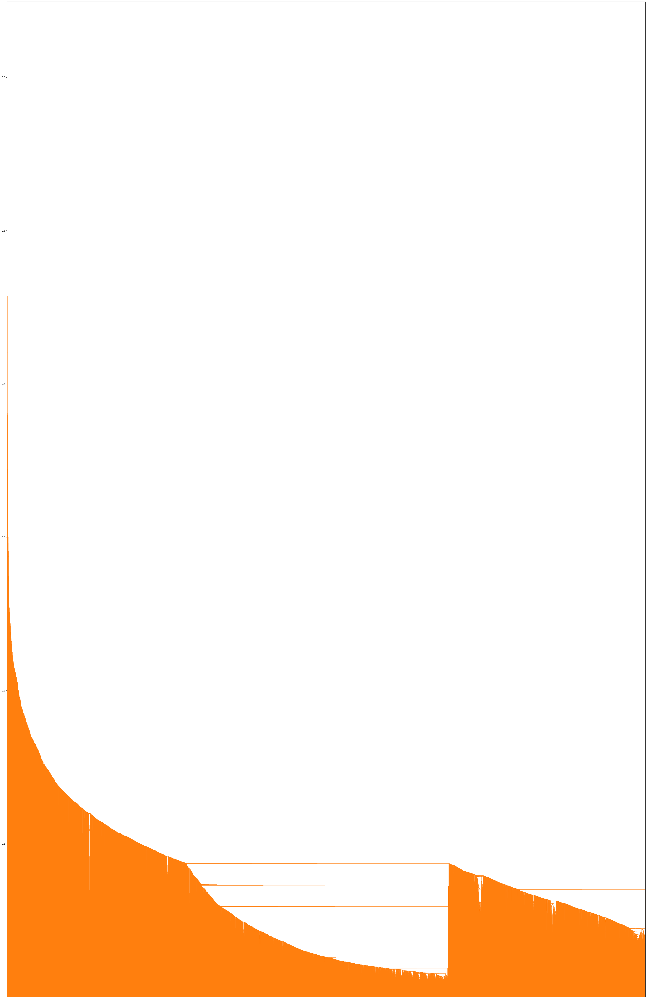

In [41]:
import sys
sys.setrecursionlimit(10000)

plt.figure(figsize=(50, 80))
ax1 = plt.subplot(1, 1, 1)
dendro_single = dendrogram(
    dist_linkage_single,
    labels=corr_T2_T3_abs.columns.tolist(),
    ax=ax1,
    leaf_rotation=90,
    no_labels=True,
    color_threshold=10,
    # p=100,
    # truncate_mode='level',
)
plt.show()
plt.close()

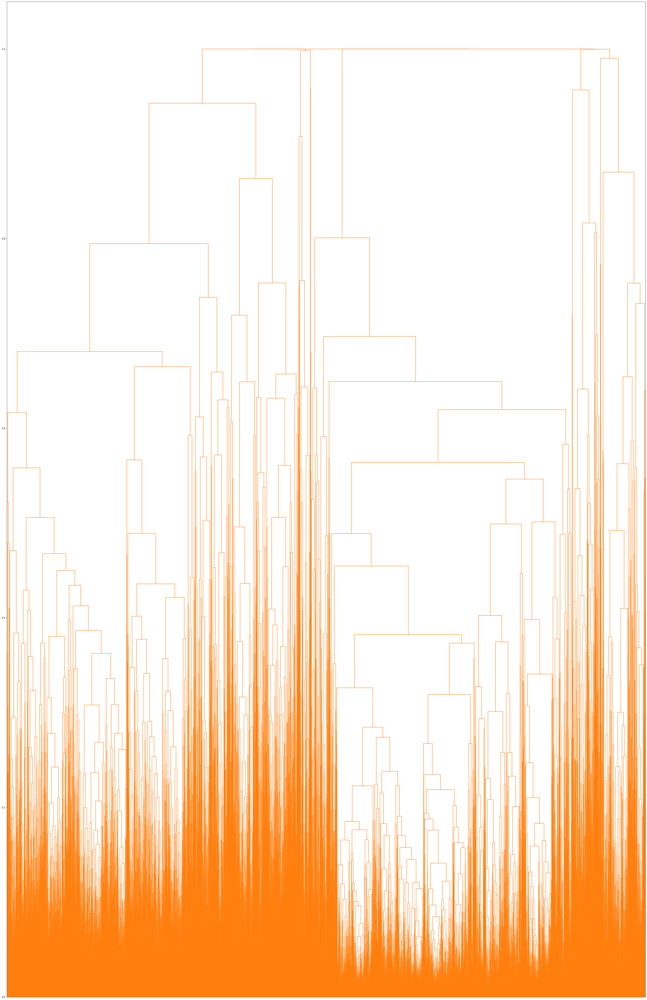

In [42]:
# import sys
# sys.setrecursionlimit(10000)

plt.figure(figsize=(50, 80))
ax1 = plt.subplot(1, 1, 1)
dendro_complete = dendrogram(
    dist_linkage_complete,
    labels=corr_T2_T3_abs.columns.tolist(),
    ax=ax1,
    leaf_rotation=90,
    no_labels=True,
    color_threshold=10,
    # p=100,
    # truncate_mode='level',
)
plt.show()
plt.close()

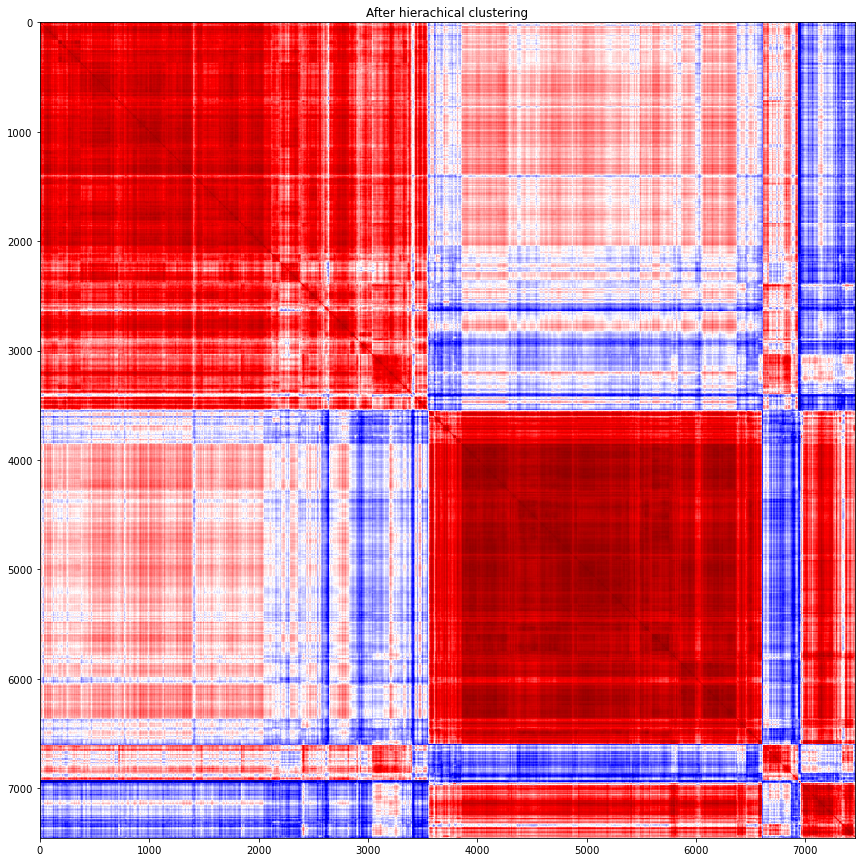

In [43]:
plt.figure(figsize=(15, 15))
plt.imshow(corr_T2_T3_abs.to_numpy()[dendro_complete["leaves"], :][:, dendro_complete["leaves"]], cmap="seismic")
plt.title("After hierachical clustering")
plt.show()
plt.close()

In [45]:
from scipy.cluster.hierarchy import fcluster
from collections import defaultdict


cluster_ids = fcluster(dist_linkage_complete, 0.2, criterion='distance')
cluster_id_to_feature_ids = defaultdict(list)
for idx, cluster_id in enumerate(cluster_ids):
    cluster_id_to_feature_ids[cluster_id].append(idx)
selected_features = [v[0] for v in cluster_id_to_feature_ids.values()]

print(selected_features)

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 41, 42, 43, 49, 57, 58, 60, 61, 62, 64, 65, 67, 68, 69, 70, 71, 72, 73, 75, 76, 77, 79, 80, 82, 83, 84, 85, 86, 87, 89, 90, 92, 93, 94, 95, 96, 98, 99, 100, 103, 104, 106, 108, 110, 111, 112, 113, 114, 115, 116, 117, 119, 120, 121, 124, 125, 126, 127, 128, 129, 130, 131, 133, 135, 136, 137, 140, 141, 142, 143, 151, 153, 157, 159, 162, 164, 170, 172, 173, 174, 175, 176, 179, 180, 183, 186, 187, 188, 189, 190, 193, 195, 196, 197, 198, 200, 202, 203, 205, 207, 210, 211, 214, 215, 216, 219, 220, 221, 224, 225, 226, 227, 228, 230, 236, 238, 240, 244, 246, 247, 248, 251, 253, 254, 257, 258, 259, 260, 263, 269, 270, 271, 273, 274, 276, 279, 280, 284, 288, 289, 291, 293, 294, 295, 298, 300, 302, 303, 305, 306, 310, 322, 323, 324, 325, 326, 327, 330, 331, 332, 336, 339, 344, 350, 355, 356, 360, 361, 364, 367, 372, 375, 376, 378, 379, 381, 384, 38

In [11]:
from sklearn.cluster import AffinityPropagation

clustering_affinity = AffinityPropagation(random_state=5, affinity='precomputed').fit(corr_T2_T3.to_numpy())

In [ ]:
from sklearn import metrics

cluster_centers_indices = clustering_affinity.cluster_centers_indices_
labels = clustering_affinity.labels_

n_clusters_ = len(cluster_centers_indices)

print("Estimated number of clusters: %d" % n_clusters_)
#print(
#    "Silhouette Coefficient: %0.3f"
#    % metrics.silhouette_score(corr_T1_T3.to_numpy(), labels, metric="precomputed")
#)

In [ ]:
fit_data = corr_T2_T3.to_numpy()[np.argsort(clustering_affinity.labels_)]
fit_data = fit_data[:, np.argsort(clustering_affinity.labels_)]

plt.figure(figsize=(15, 15))
plt.imshow(fit_data, cmap="seismic", vmin=-1, vmax=1)
plt.title("After affinity clustering; rearranged to show clusters")
plt.show()
plt.close()

In [ ]:
from sklearn.cluster import OPTICS

clustering_optics = OPTICS(min_samples=2, metric='precomputed').fit(distance_matrix)
clustering_optics.labels_

In [ ]:
clustering_optics.labels_.max()

In [ ]:
fit_data = distance_matrix[np.argsort(clustering_optics.labels_)]
fit_data = fit_data[:, np.argsort(clustering_optics.labels_)]

plt.figure(figsize=(15, 15))
plt.imshow(fit_data, cmap="seismic")
plt.title("After OPTICS clustering; rearranged to show clusters")
plt.show()
plt.close()